In [18]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '5'

import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2

In [19]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=150):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.75)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.75)   

def show_points_00(coords, labels, ax, marker_size=150):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='yellow', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))    


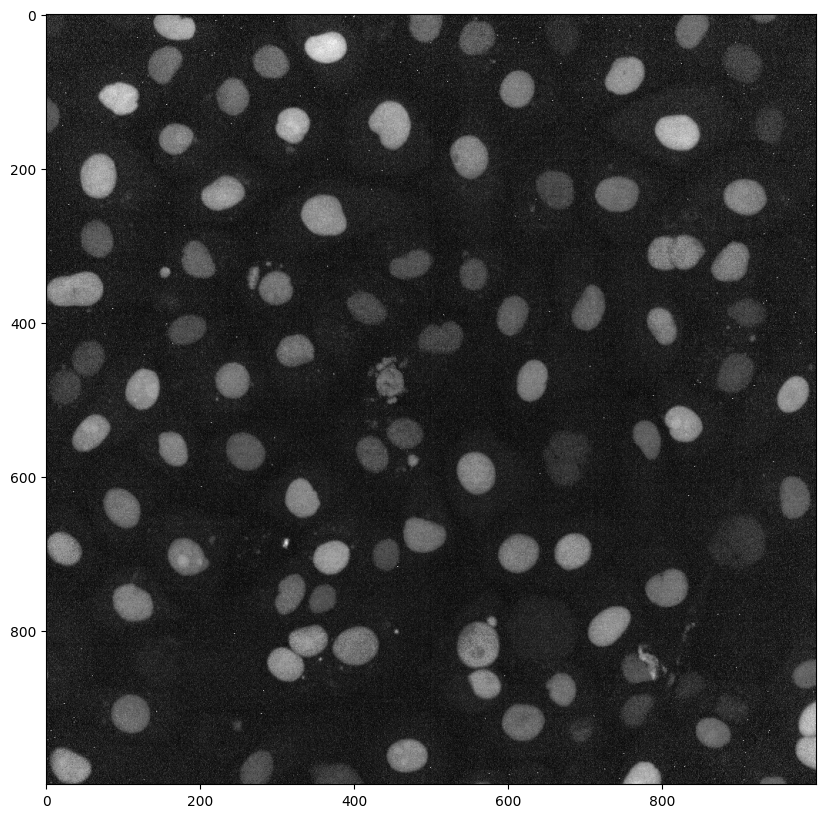

In [20]:
# image = cv2.imread('images/truck.jpg')
# plt.imshow(image)
# image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
# # plt.imshow(image)

import skimage.io as skio
# from tifffile import imread, imwrite
root_path = r'/data/sunrui/celldata/F0005/'
file_name = r'F0005.tif'

img_raw = skio.imread(root_path + r'/PRE/test.tif',plugin="tifffile")

image = img_raw[4]#302

plt.figure(figsize=(10,10))
plt.imshow(image,cmap='gray')
plt.axis('on')
plt.show()

In [21]:
# plt.figure(figsize=(10,10))
# plt.imshow(img_raw[176],cmap='gray')#302
# plt.axis('on')
# plt.show()

In [22]:
# print(image.shape)
# image = image.squeeze()
# print(image.shape)
# image = cv2.cvtColor(image,cv2.COLOR_GRAY2RGB)
# print(image.shape)

In [23]:
# image_folder =r'/home/zhangjinlei/research/segment-anything/zjl_outputs_temp'
# if not os.path.exists(image_folder):
#     os.makedirs(image_folder)

In [24]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor, SamAutomaticMaskGenerator

sam_checkpoint = "/home/sunrui/cellwork/sam/segment-anything/notebooks/sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)



In [25]:
# predictor.set_image(image)

# # input_point = np.array([[285, 373],[289,370],[265,375],[495,445]])
# # input_label = np.array([1,1,1,1])
# input_point = np.array([[810, 115]])
# input_label = np.array([1])

# # mask_input = logits[np.argmax(scores), :, :]  # Choose the model's best mask
# #todo 这个参数什么用？


# masks, _, _ = predictor.predict(
#     point_coords=input_point,
#     point_labels=input_label,
#     #mask_input=mask_input[None, :, :],
#     #todo 能注释吗？
#     multimask_output=False,
# )

# masks.shape

In [26]:
# plt.figure(figsize=(10,10))
# plt.imshow(image)
# show_mask(masks, plt.gca())
# show_points(input_point, input_label, plt.gca())
# plt.axis('off')
# plt.show() 

In [27]:
# import sys
# sys.path.append('/home/sunrui/cellwork/sam/segment-anything')

# from segment_anything.utils.amg import batched_mask_to_box

# # print(masks)
# print(1)
# np.where(masks==True)
# masks.shape
# batched_mask_to_box(mask)

In [28]:
def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        # color_mask = np.concatenate([np.array([0.41081098, 0.78456671, 0.15726209]), [0.35]])
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
        #todo
    ax.imshow(img)

In [29]:
# np.random.random(3)

In [30]:
# plt.figure(figsize=(10,10))
# plt.imshow(img_raw[156],cmap='gray')
# plt.axis('on')
# plt.show()

In [31]:
# mask_generator = SamAutomaticMaskGenerator(model=sam,pred_iou_thresh=0.95)
# masks = mask_generator.generate(image)
# print(len(masks))
# print(masks[0].keys())


In [32]:
# for img in img_raw[300:,:, :, : ]:
#     img = img.squeeze()
#     img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
#     mask_generator = SamAutomaticMaskGenerator(sam)
#     masks = mask_generator.generate(img)
#     plt.figure(figsize=(15,15))
#     plt.imshow(img)
#     show_anns(masks)
#     #show_points(masks[0]['point_coords'],np.array([1]), plt.gca())
#     plt.axis('off')
#     plt.show()

In [33]:
# a=masks[0]['segmentation']
# print(a.shape)
# print(masks)


first_frame:


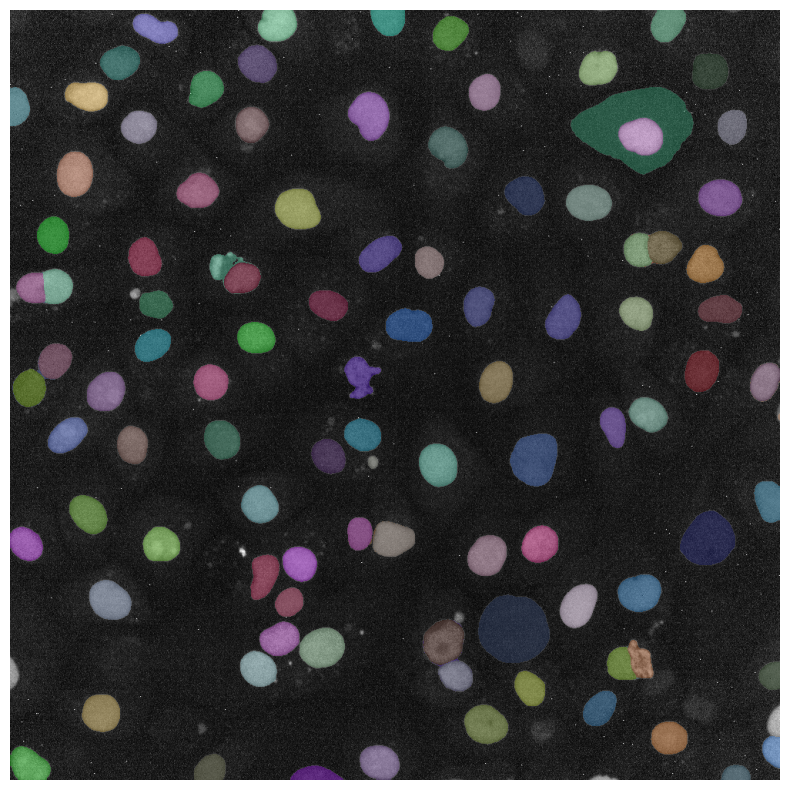

/////////////////////////////


186327
masks_new_auto_result:


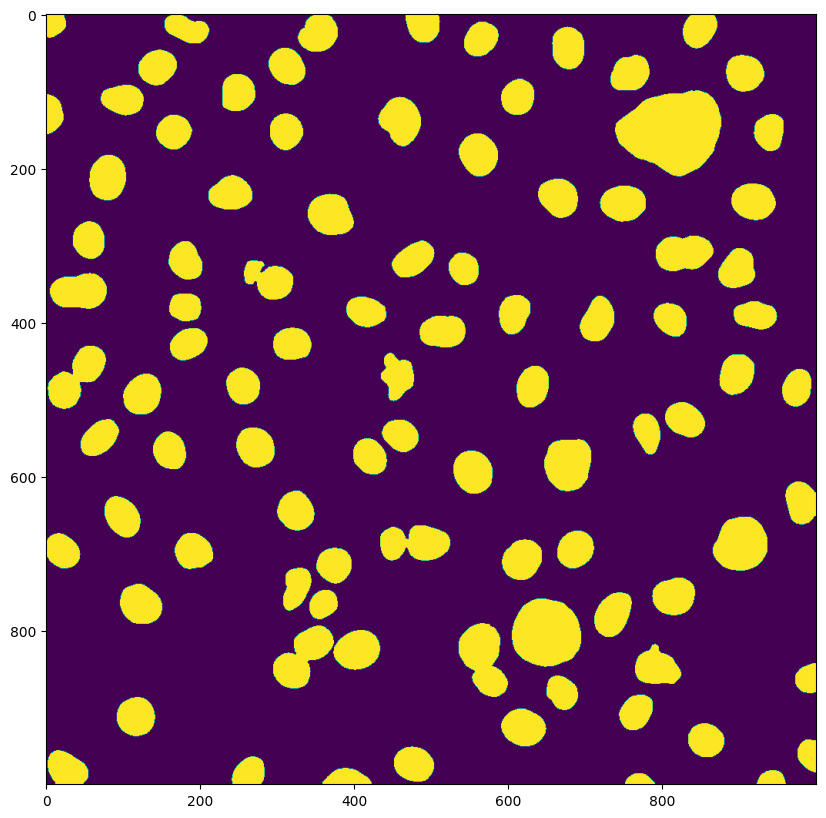

//////////////////
box: [8, 336, 73, 45]
masks_new_auto_result True
[44, 358] is True in new masks
box: [322, 0, 50, 40]
masks_new_auto_result True
[347, 20] is True in new masks
box: [100, 470, 49, 50]
masks_new_auto_result False
[124, 495] is True in new masks
box: [0, 956, 52, 43]
masks_new_auto_result False
[26, 977] is True in new masks
box: [594, 682, 50, 52]
masks_new_auto_result False
[619, 708] is True in new masks
box: [293, 126, 43, 46]
masks_new_auto_result False
[314, 149] is True in new masks
box: [159, 5, 58, 38]
masks_new_auto_result False
[188, 24] is True in new masks
box: [878, 305, 49, 49]
masks_new_auto_result False
[902, 329] is True in new masks
box: [961, 458, 38, 49]
masks_new_auto_result True
[980, 482] is True in new masks
box: [252, 533, 46, 50]
masks_new_auto_result False
[275, 558] is True in new masks
box: [454, 955, 51, 44]
masks_new_auto_result True
[479, 977] is True in new masks
box: [609, 456, 43, 54]
masks_new_auto_result False
[630, 483] is True in

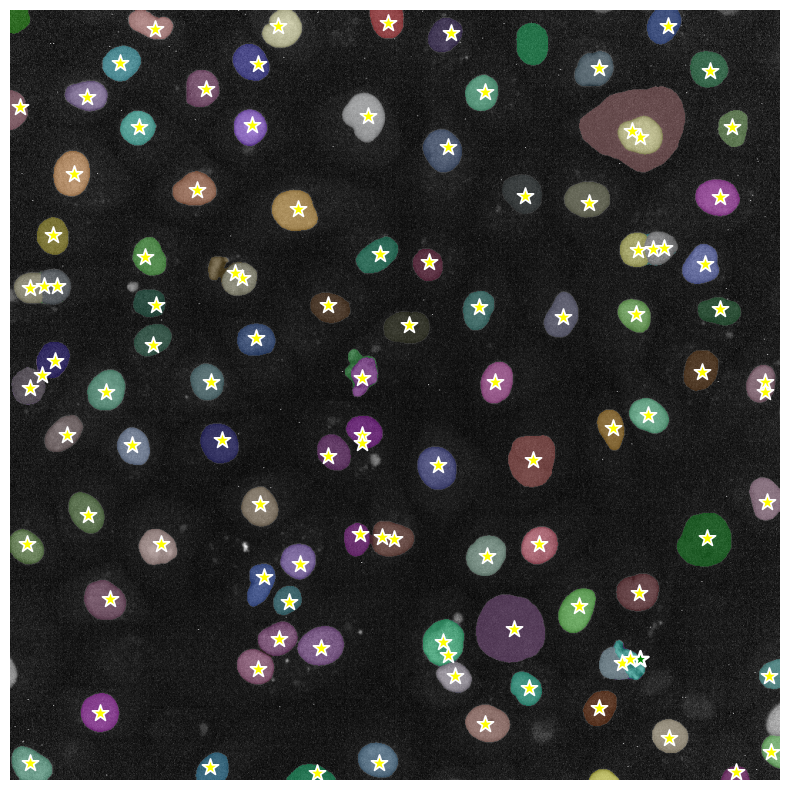

[[818, 842]]
prompts: 1
184164
masks_new_auto_result:


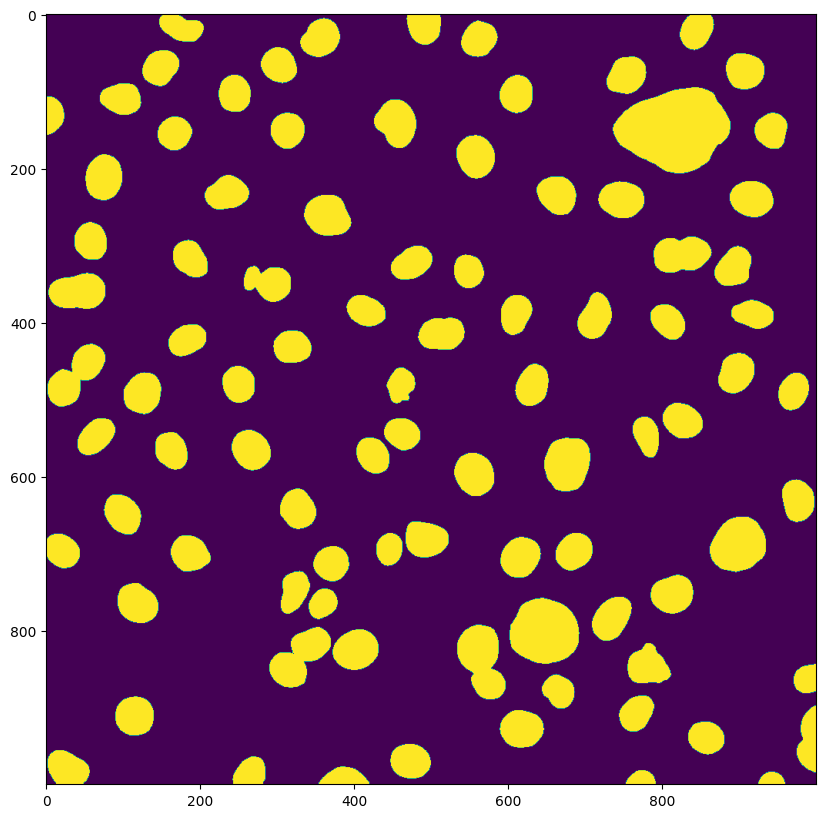

//////////////////
box: [5, 337, 73, 44]
masks_new_auto_result True
[41, 359] is True in new masks
box: [100, 467, 49, 52]
masks_new_auto_result False
[124, 493] is True in new masks
box: [2, 956, 52, 43]
masks_new_auto_result False
[28, 977] is True in new masks
box: [592, 682, 51, 52]
masks_new_auto_result False
[617, 708] is True in new masks
box: [452, 951, 51, 45]
masks_new_auto_result True
[477, 973] is True in new masks
box: [291, 129, 42, 47]
masks_new_auto_result False
[312, 152] is True in new masks
box: [471, 664, 53, 45]
masks_new_auto_result False
[497, 686] is True in new masks
box: [71, 92, 55, 39]
masks_new_auto_result True
[98, 111] is True in new masks
box: [591, 902, 58, 48]
masks_new_auto_result False
[620, 926] is True in new masks
box: [340, 233, 59, 53]
masks_new_auto_result False
[369, 259] is True in new masks
box: [611, 457, 41, 53]
masks_new_auto_result False
[631, 483] is True in new masks
box: [787, 732, 55, 48]
masks_new_auto_result False
[814, 756] is Tru

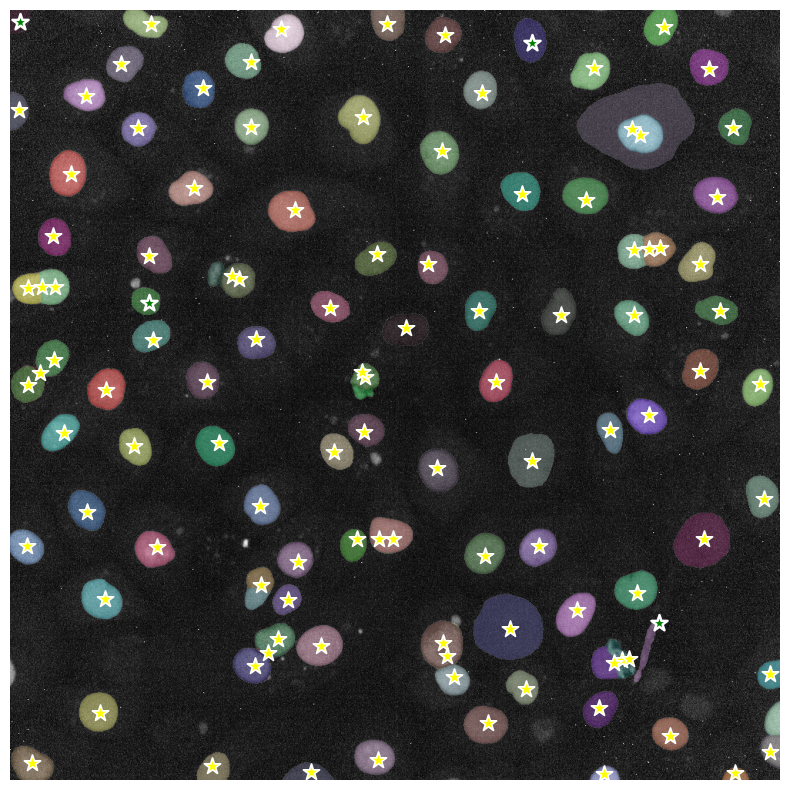

[[677, 43], [12, 15], [180, 380], [843, 795]]
prompts: 4
185924
masks_new_auto_result:


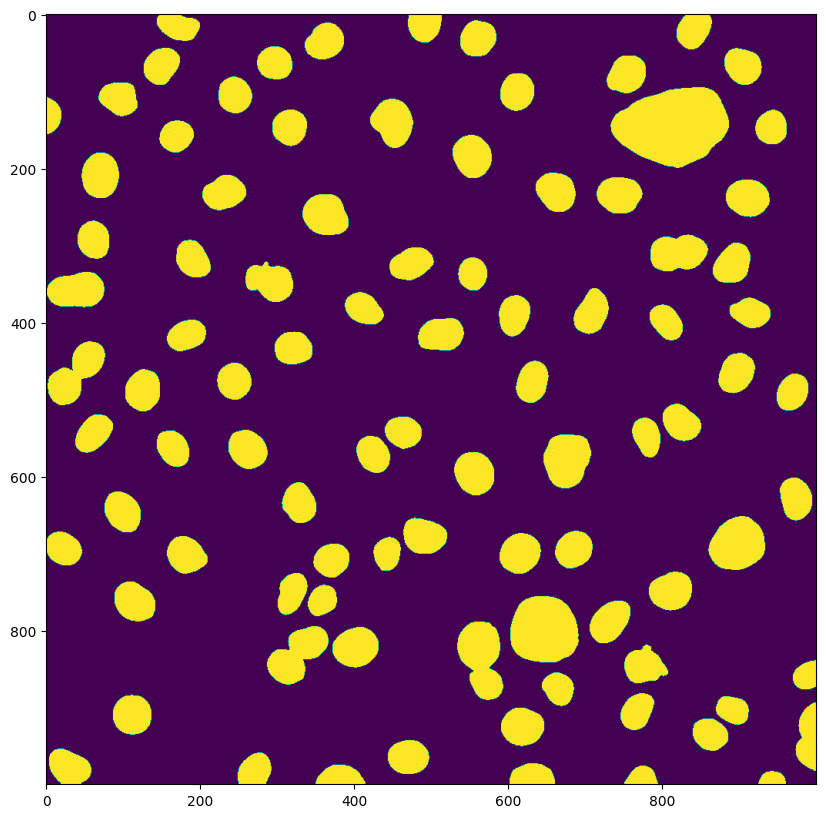

//////////////////
box: [101, 465, 48, 54]
masks_new_auto_result False
[125, 492] is True in new masks
box: [609, 454, 43, 54]
masks_new_auto_result False
[630, 481] is True in new masks
box: [789, 289, 74, 46]
masks_new_auto_result True
[826, 312] is True in new masks
box: [292, 128, 43, 46]
masks_new_auto_result False
[313, 151] is True in new masks
box: [590, 679, 52, 52]
masks_new_auto_result False
[616, 705] is True in new masks
box: [2, 956, 54, 43]
masks_new_auto_result False
[29, 977] is True in new masks
box: [3, 337, 73, 45]
masks_new_auto_result True
[39, 359] is True in new masks
box: [801, 505, 51, 45]
masks_new_auto_result False
[826, 527] is True in new masks
box: [70, 90, 53, 40]
masks_new_auto_result True
[96, 110] is True in new masks
box: [335, 235, 61, 52]
masks_new_auto_result False
[365, 261] is True in new masks
box: [709, 757, 51, 56]
masks_new_auto_result False
[734, 785] is True in new masks
box: [483, 394, 60, 41]
masks_new_auto_result False
[513, 414] is Tru

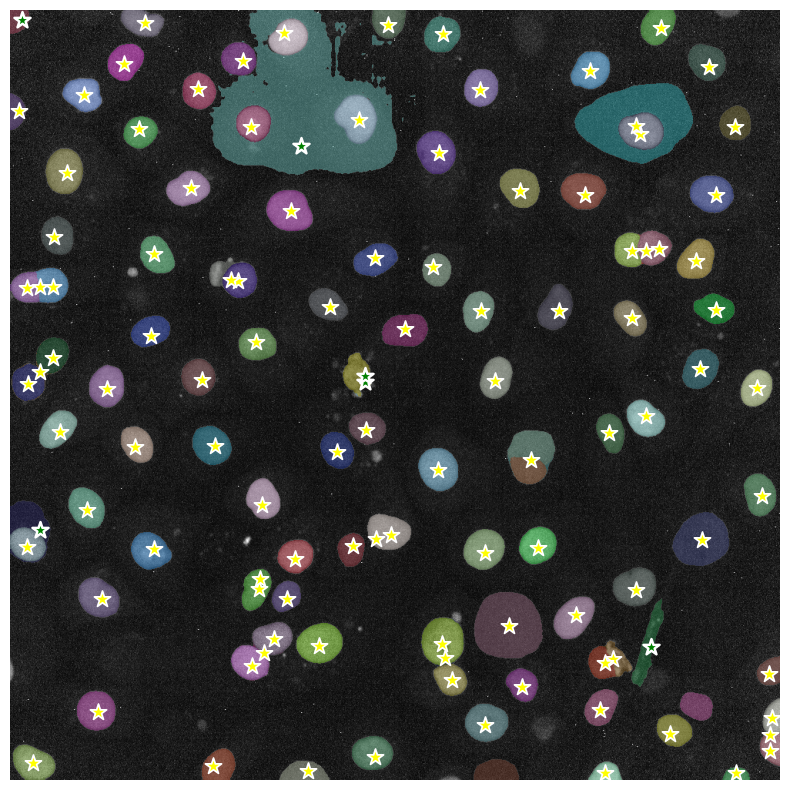

[[460, 482], [460, 475], [39, 675], [15, 12], [377, 176], [832, 827]]
prompts: 6
178737
masks_new_auto_result:


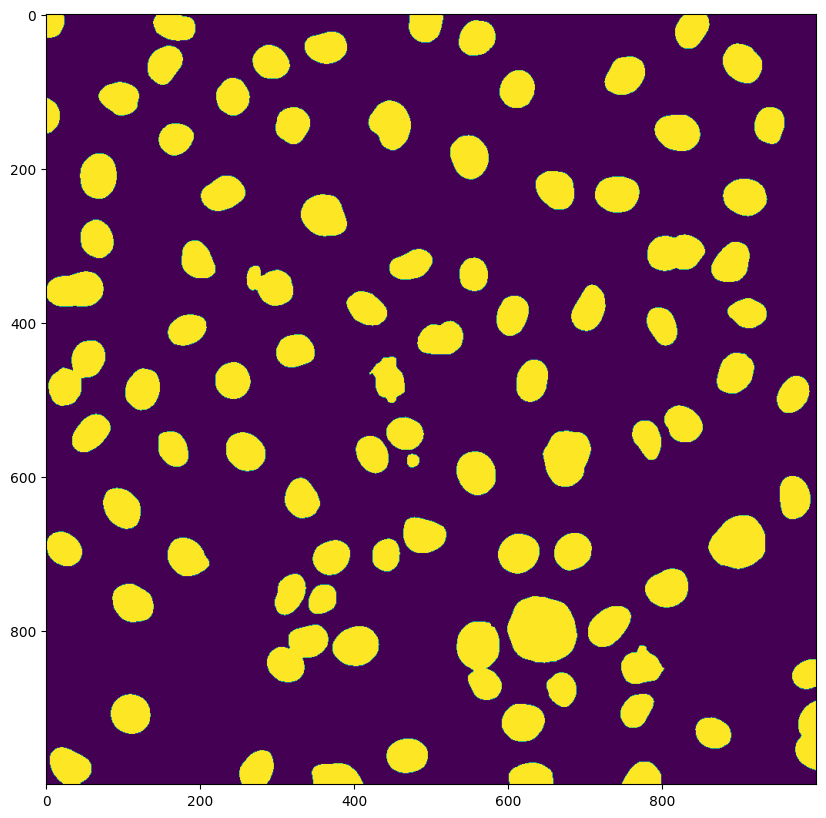

//////////////////
box: [0, 335, 75, 45]
masks_new_auto_result True
[37, 357] is True in new masks
box: [103, 461, 44, 54]
masks_new_auto_result False
[125, 488] is True in new masks
box: [4, 954, 54, 45]
masks_new_auto_result False
[31, 976] is True in new masks
box: [294, 124, 44, 47]
masks_new_auto_result False
[316, 147] is True in new masks
box: [949, 467, 40, 47]
masks_new_auto_result True
[969, 490] is True in new masks
box: [589, 674, 53, 52]
masks_new_auto_result False
[615, 700] is True in new masks
box: [347, 688, 46, 43]
masks_new_auto_result True
[370, 709] is True in new masks
box: [169, 293, 44, 48]
masks_new_auto_result False
[191, 317] is True in new masks
box: [38, 520, 48, 49]
masks_new_auto_result False
[62, 544] is True in new masks
box: [68, 89, 50, 43]
masks_new_auto_result True
[93, 110] is True in new masks
box: [46, 180, 48, 58]
masks_new_auto_result False
[70, 209] is True in new masks
box: [706, 762, 52, 54]
masks_new_auto_result True
[732, 789] is True in n

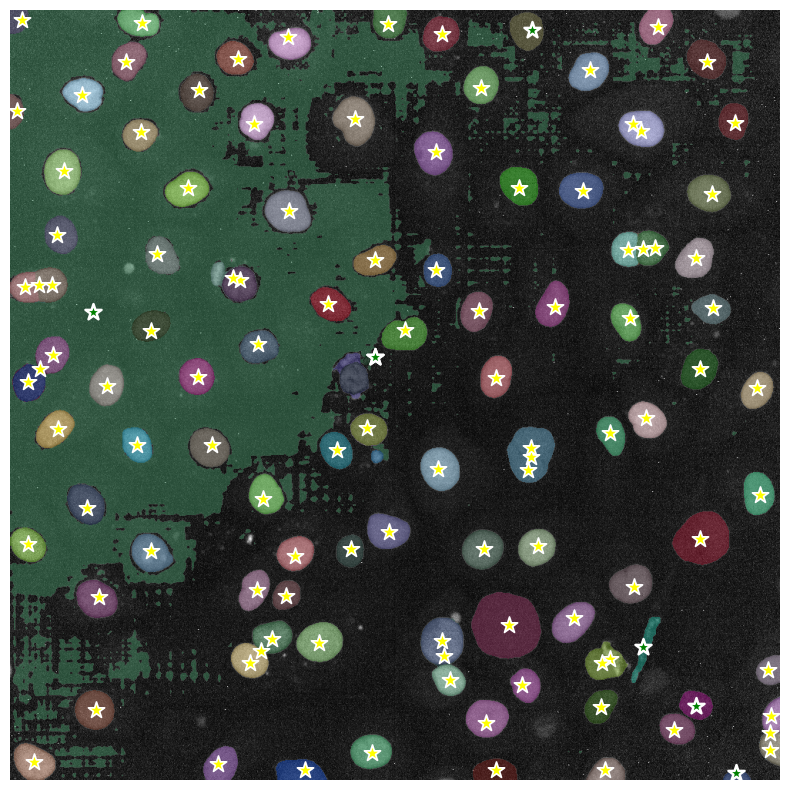

[[942, 991], [891, 904], [473, 450], [473, 450], [677, 26], [107, 392], [821, 827]]
prompts: 7
195429
masks_new_auto_result:


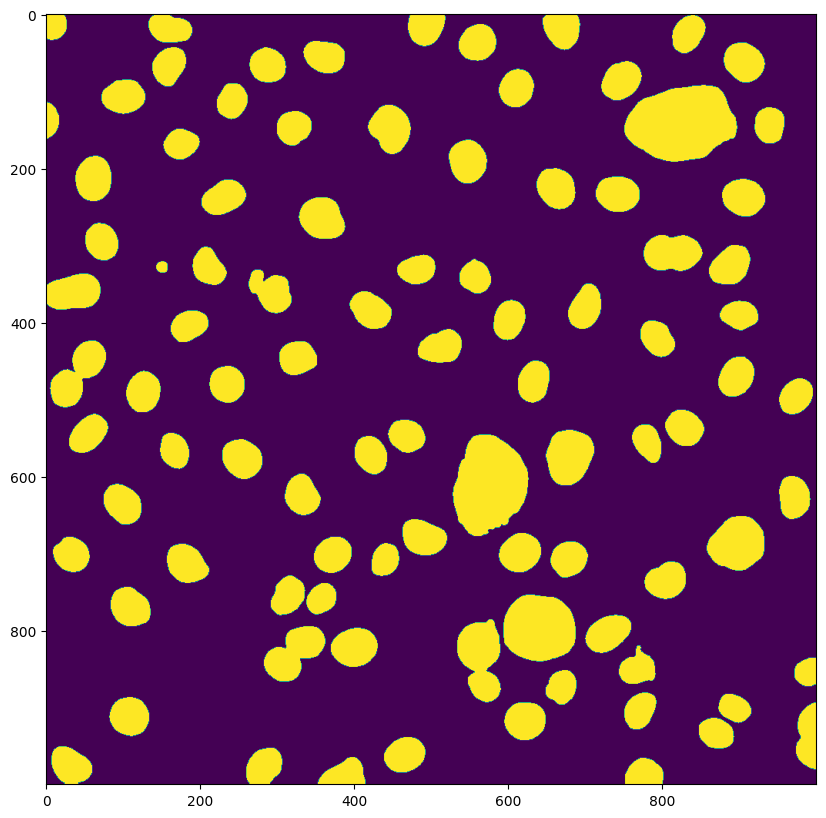

//////////////////
box: [0, 335, 74, 44]
masks_new_auto_result True
[37, 357] is True in new masks
box: [103, 460, 44, 54]
masks_new_auto_result False
[125, 487] is True in new masks
box: [611, 449, 40, 54]
masks_new_auto_result False
[631, 476] is True in new masks
box: [346, 683, 48, 45]
masks_new_auto_result True
[370, 705] is True in new masks
box: [44, 181, 47, 58]
masks_new_auto_result False
[67, 210] is True in new masks
box: [84, 883, 51, 51]
masks_new_auto_result False
[109, 908] is True in new masks
box: [587, 675, 53, 51]
masks_new_auto_result False
[613, 700] is True in new masks
box: [5, 952, 53, 47]
masks_new_auto_result False
[31, 975] is True in new masks
box: [68, 88, 52, 43]
masks_new_auto_result True
[94, 109] is True in new masks
box: [949, 470, 42, 47]
masks_new_auto_result False
[970, 493] is True in new masks
box: [34, 519, 49, 49]
masks_new_auto_result False
[58, 543] is True in new masks
box: [725, 55, 52, 49]
masks_new_auto_result False
[751, 79] is True in ne

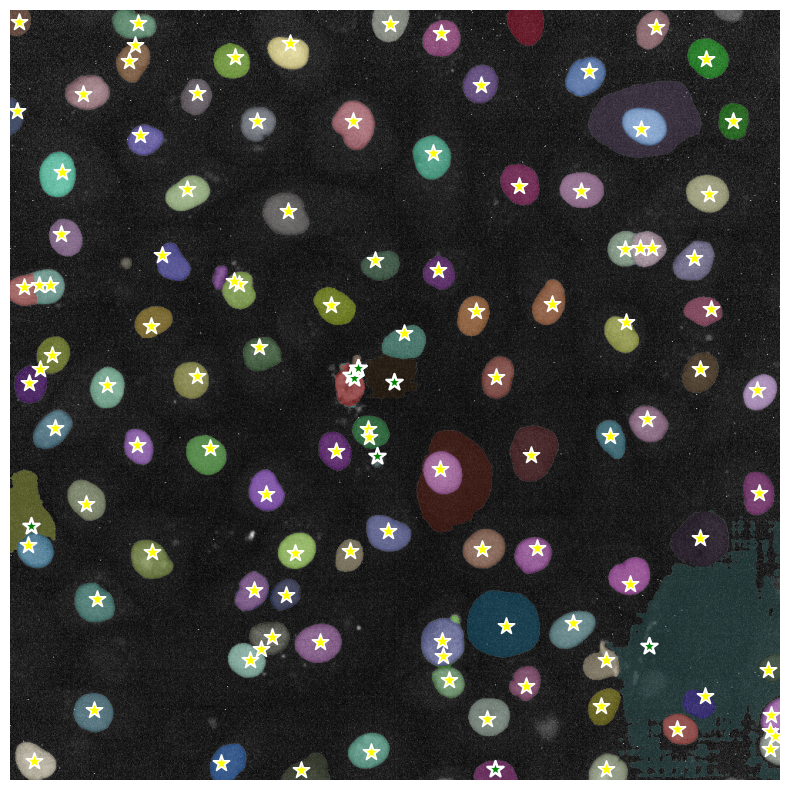

[[442, 474], [446, 478], [629, 985], [476, 579], [452, 464], [452, 464], [27, 670], [498, 483], [830, 825]]
prompts: 9


In [35]:
from typing import List
# from .utils.amg import batched_mask_to_box        为啥不行？


# def get_prompts_from_masks(masks) -> List[int]:
#     prompts=[]
#     for mask in masks:
#         box=mask[bbox]
#         prompts.append([box[0]+box[2]//2, box[1]+box[3]//2])
#     return prompts
# def is_prompt_exist(prompts, masks) -> List[int]:
#     return

def get_masks_new(image, prompts, masks_new_auto):
    predictor.set_image(image)                          #predictor依赖
    for prompt in prompts:
        input_point = np.array([prompt])
        input_label = np.array([1])
        #mask_input = logits[np.argmax(scores), :, :]  # Choose the model's best mask

        mask, _, _ = predictor.predict(
        point_coords=input_point,
        point_labels=input_label,
        #mask_input=mask_input[None, :, :],
        multimask_output=False,
        )
        mask=mask.squeeze()
        # box = batched_mask_to_box(mask)
        xyxy = np.where(mask)
        x1,y1,x2,y2 = xyxy[0].min(), xyxy[1].min(), xyxy[0].max(), xyxy[1].max()
        bbox= [x1,y1,x2-x1,y2-y1]
        area= len(xyxy[0])

        masks_new_auto.append(
            {
                'segmentation':mask,
                'bbox':bbox,
                'area':area
            }
        )
        # print('helloworld')
    return masks_new_auto

def prompts_of_disappear_masks(img, masks_old, masks_new_auto):
    prompts_1 = []
    prompts_00=[]
    masks_new_auto_result = np.zeros((masks_new_auto[0]['segmentation'].shape[0], masks_new_auto[0]['segmentation'].shape[1]))       #1000*1000
    back = np.zeros((masks_new_auto[0]['segmentation'].shape[0], masks_new_auto[0]['segmentation'].shape[1]))
    for mask in masks_new_auto:
        masks_new_auto_result = np.logical_or(masks_new_auto_result, mask['segmentation'])
    print(len(np.where(masks_new_auto_result)[0]))



    print('masks_new_auto_result:')
    plt.figure(figsize=(10,10))
    plt.imshow(masks_new_auto_result)
    plt.show()
    print('//////////////////')
    # ann=[{'segmentation':masks_new_auto_result,
    #             #'bbox':bbox,
    #             'area':len(np.where(masks_new_auto_result)[0])}]
    # plt.figure(figsize=(10,10))
    # plt.imshow(back)
    # show_anns(ann)
    # plt.axis('off')
    # plt.show()
    # print(masks_new_auto_result)
    # if  masks_new_auto_result[0,0]==0:print('fuck')
    sum=0
    for mask in masks_old:
        box=mask['bbox']
        print('box:',box)
        if not masks_new_auto_result[box[1]+box[3]//2,box[0]+box[2]//2]:
            prompts_1.append([box[0]+box[2]//2, box[1]+box[3]//2])
            print('masks_new_auto_result',masks_new_auto_result[box[0]+box[2]//2, box[1]+box[3]//2])
            print(prompts_1[-1],"is not True in new masks")
            sum+=1
        else:
            prompts_00.append([box[0]+box[2]//2, box[1]+box[3]//2])
            print('masks_new_auto_result',masks_new_auto_result[box[0]+box[2]//2, box[1]+box[3]//2])
            print([box[0]+box[2]//2, box[1]+box[3]//2],"is True in new masks")
        # plt.figure(figsize=(10,10))
        # plt.subplot(1,2,1)
        # plt.imshow(img)
        # show_points(np.array([[box[0]+box[2]//2, box[1]+box[3]//2]]) ,np.array([1]), plt.gca(),marker_size = 50)
        # show_anns(masks_new_auto)
        # plt.subplot(1,2,2)
        # plt.imshow(masks_new_auto_result)
        # show_points(np.array([[box[0]+box[2]//2, box[1]+box[3]//2]]) ,np.array([1]), plt.gca(),marker_size = 50)
        # plt.show()
    # for mask in masks_old:
    #     box=mask['bbox']
    #     prompts_00.append([box[0]+box[2]//2, box[1]+box[3]//2])
    #     print([box[0]+box[2]//2, box[1]+box[3]//2],"is True in new masks")

    # for mask in masks_new_auto:
    #     box=mask['bbox']
    #     prompts_1.append([box[0]+box[2]//2, box[1]+box[3]//2])
    #     print([box[0]+box[2]//2, box[1]+box[3]//2],"is True in new masks")
    print("sum is", sum)

    return prompts_1, prompts_00



mask_generator = SamAutomaticMaskGenerator(sam,pred_iou_thresh=0.95)
img=img_raw[0]
img = img.squeeze()
img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
masks_old = mask_generator.generate(img)
masks_new = masks_old

print('first_frame:')
plt.figure(figsize=(10,10))
plt.imshow(img)
show_anns(masks_new)
# show_points(masks[0]['point_coords'],np.array([1]), plt.gca())
plt.axis('off')
plt.show()
print('/////////////////////////////')
prompts_1 = []
prompts_00 = []
# prompts=[]
for img in img_raw[1:6,:, :, : ]:
    img = img.squeeze()
    img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
    masks_new_auto = mask_generator.generate(img)
    

    prompts_1, prompts_00 = prompts_of_disappear_masks(img, masks_old, masks_new_auto)
    
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    
    for prompt in prompts_1:
        show_points(np.array([prompt]) ,np.array([1]), plt.gca())
        # show_box(np.array([prompt]), plt.gca())
    for prompt_00 in prompts_00:
        show_points_00(np.array([prompt_00]) ,np.array([1]), plt.gca())
        # show_box(np.array([prompt_00]), plt.gca())
    # show_points(masks[0]['point_coords'],np.array([1]), plt.gca())
    masks_new = get_masks_new(img, prompts_1, masks_new_auto)
    show_anns(masks_new)
    plt.axis('off')
    plt.show()
    print(prompts_1)
    print("prompts:",len(prompts_1))
    masks_old=masks_new


In [19]:
np.array([True])|np.array([True,False])
a= [[1,2],
    [3,4]]
# a[(1,1)]
b=(True,False,True)
b=np.array(b)
zjl=np.array([[False, False, False],
        [False, False, False]
        ])
#masks=masks.squeeze()
# len(np.where(masks==True)[1])
zjl2=zjl=np.array([[False, False, False],
        [False, True, False]
        ])
# zjl or zjl2
np.logical_or(zjl,zjl2)
np.zeros((2,2))
np.append(np.zeros((2,2)),([1,1]))

array([0., 0., 0., 0., 1., 1.])

In [20]:
mask_generator = SamAutomaticMaskGenerator(sam,pred_iou_thresh=0.95)
img=img_raw[0]
img = img.squeeze()
img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
masks_old = mask_generator.generate(img)

/home/sunrui/cellwork/sam/segment-anything/segment_anything/utils/amg.py:118: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /opt/conda/conda-bld/pytorch_1607370172916/work/torch/csrc/utils/python_arg_parser.cpp:882.)
  change_indices = diff.nonzero()


first_frame:


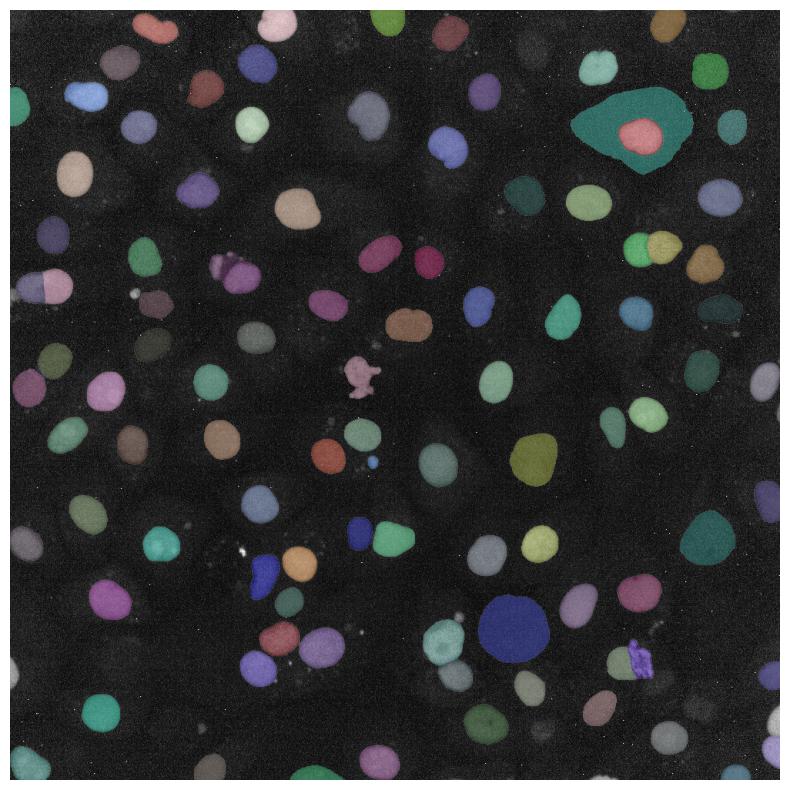

/////////////////////////////
186327
masks_new_auto_result:


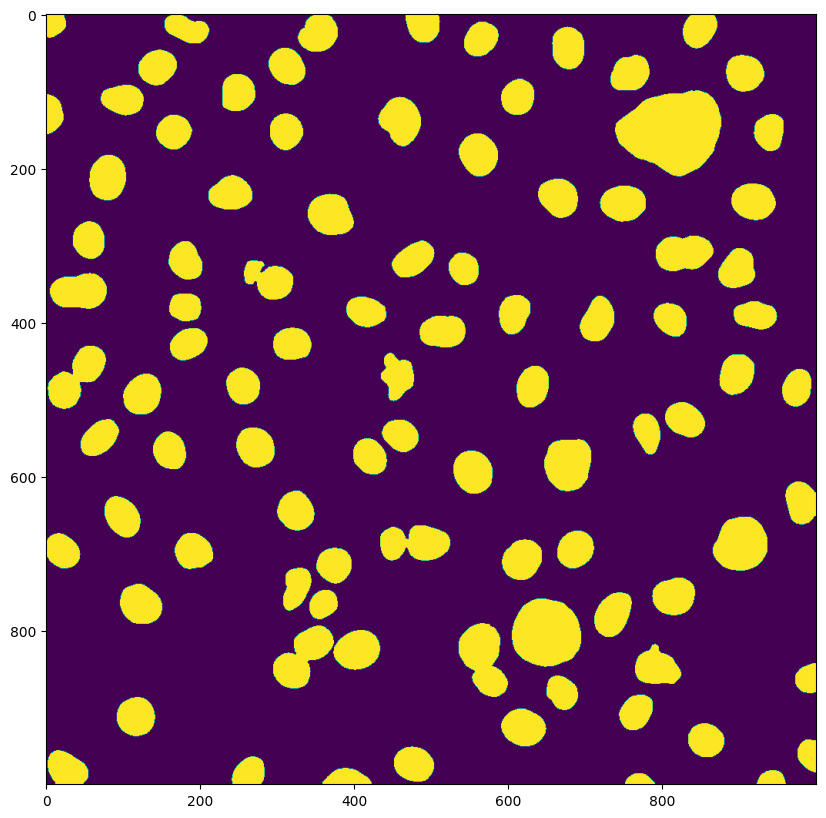

//////////////////
box: [8, 336, 73, 45]
masks_new_auto_result True
[44, 358] is True in new masks


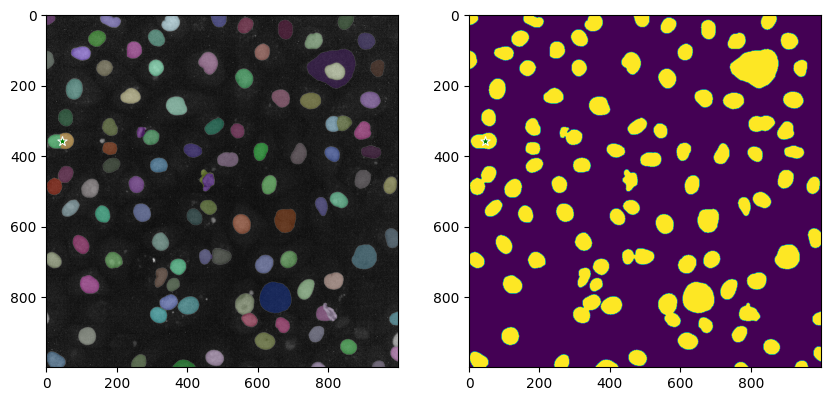

box: [322, 0, 50, 40]
masks_new_auto_result True
[347, 20] is True in new masks


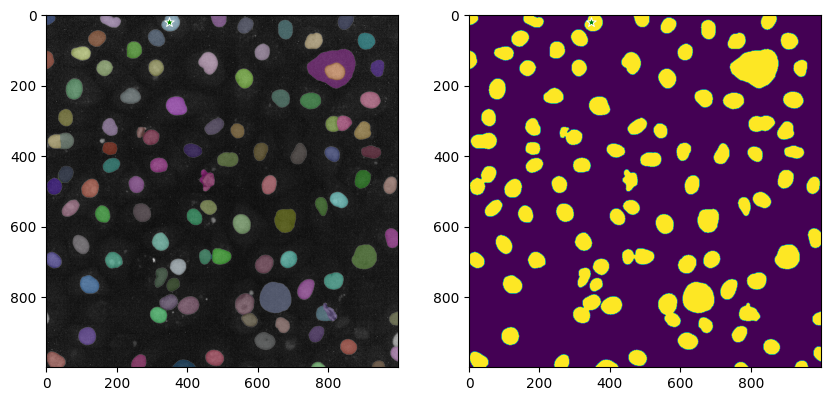

box: [100, 470, 49, 50]
masks_new_auto_result False
[124, 495] is not True in new masks


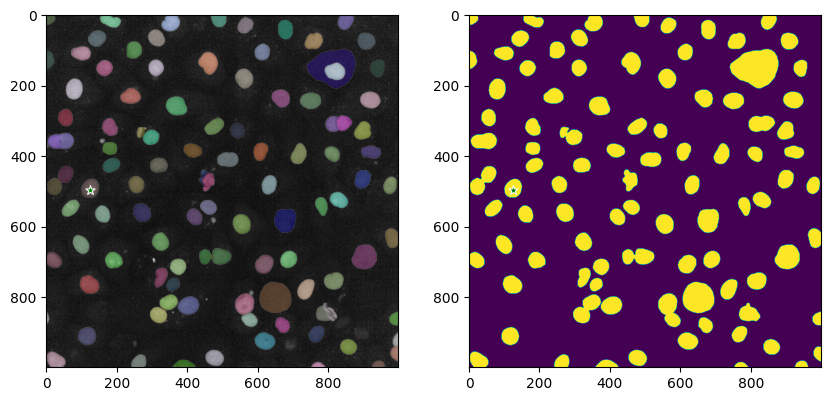

box: [0, 956, 52, 43]
masks_new_auto_result False
[26, 977] is not True in new masks


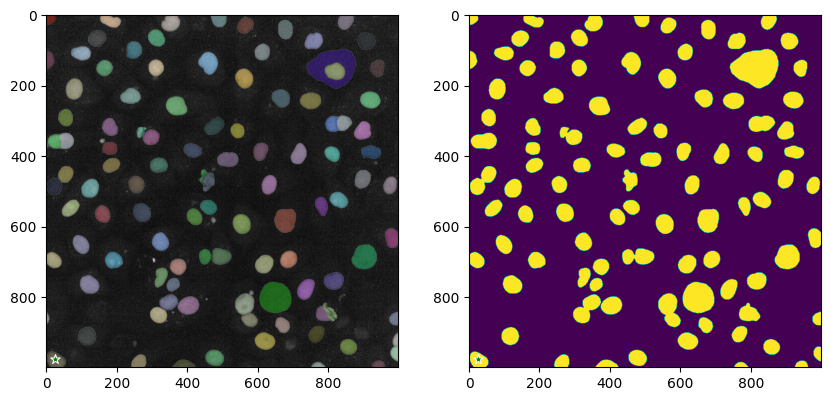

box: [594, 682, 50, 52]
masks_new_auto_result False
[619, 708] is not True in new masks


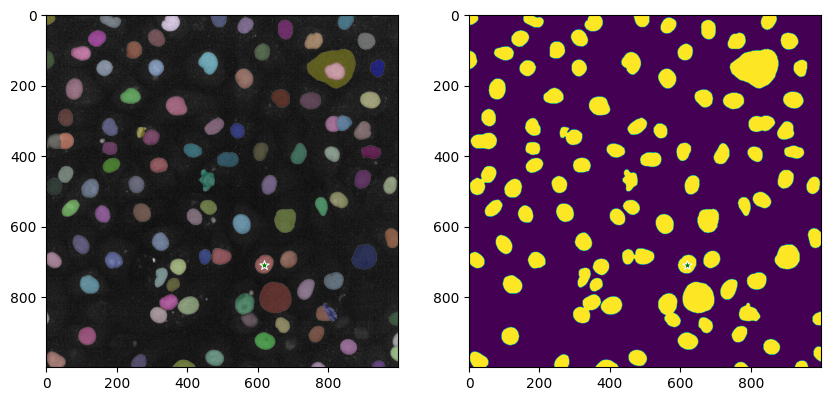

box: [293, 126, 43, 46]
masks_new_auto_result False
[314, 149] is not True in new masks


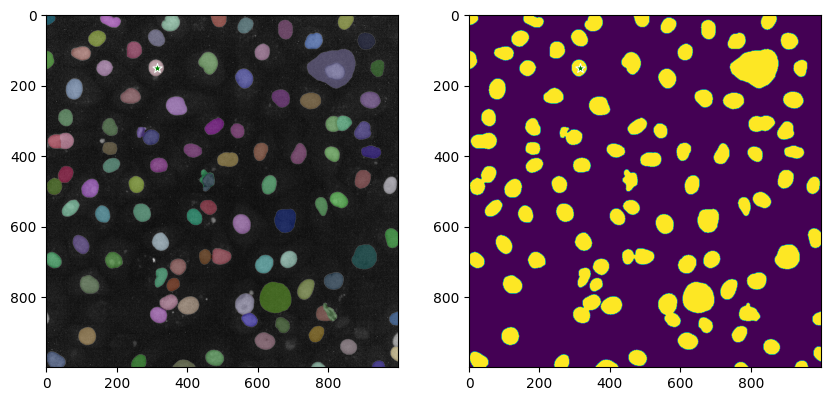

box: [159, 5, 58, 38]
masks_new_auto_result False
[188, 24] is not True in new masks


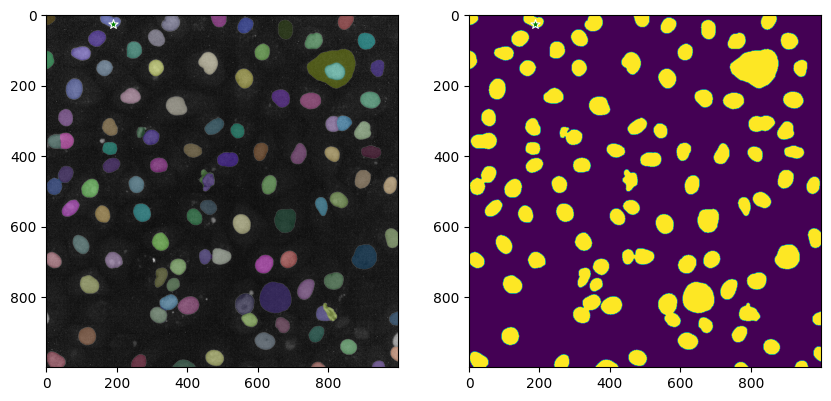

box: [878, 305, 49, 49]
masks_new_auto_result False
[902, 329] is not True in new masks


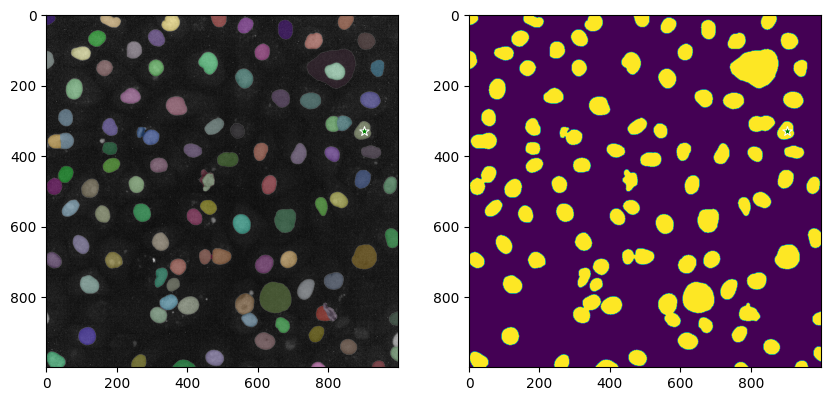

box: [961, 458, 38, 49]
masks_new_auto_result True
[980, 482] is True in new masks


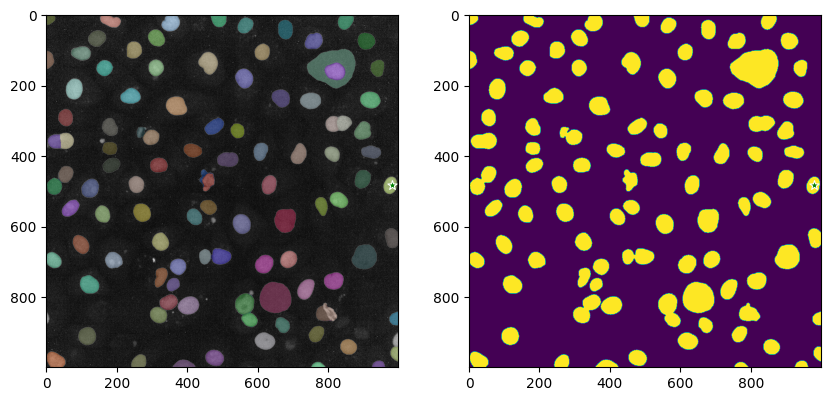

box: [252, 533, 46, 50]
masks_new_auto_result False
[275, 558] is not True in new masks


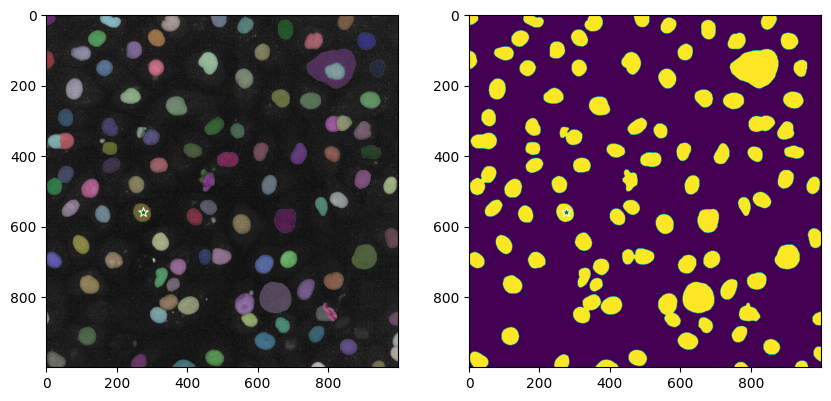

box: [454, 955, 51, 44]
masks_new_auto_result True
[479, 977] is True in new masks


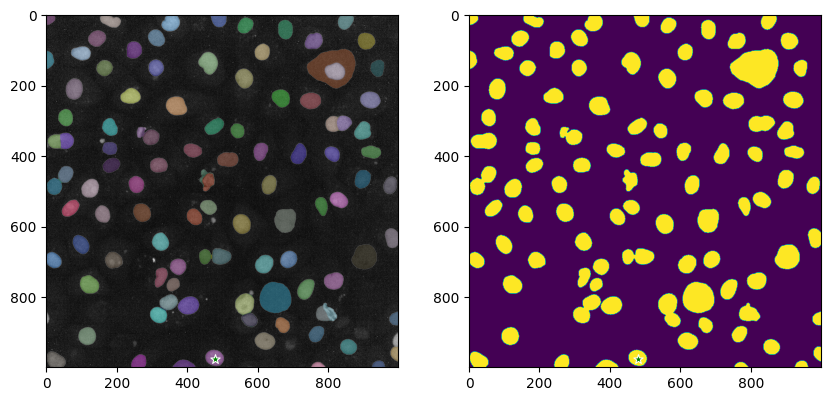

box: [609, 456, 43, 54]
masks_new_auto_result False
[630, 483] is not True in new masks


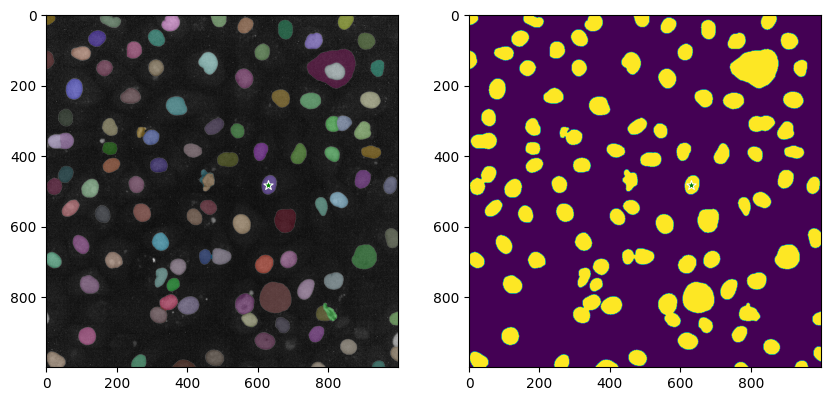

box: [375, 802, 59, 52]
masks_new_auto_result True
[404, 828] is True in new masks


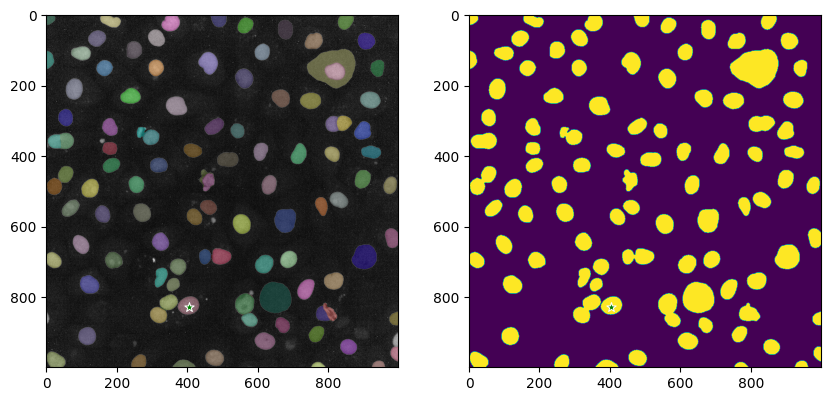

box: [714, 745, 48, 57]
masks_new_auto_result False
[738, 773] is not True in new masks


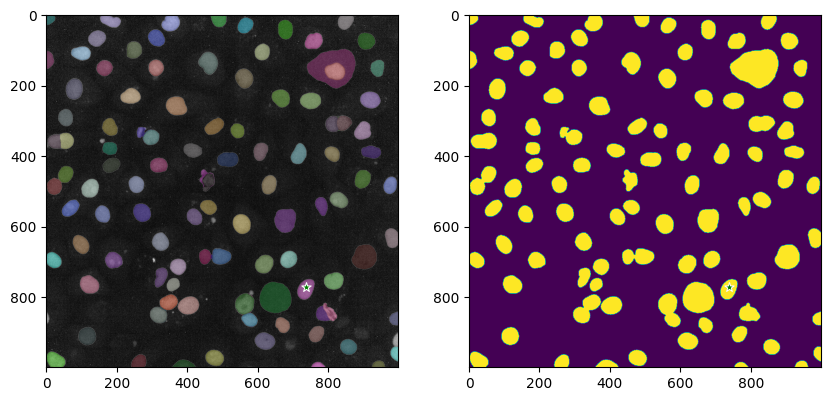

box: [344, 232, 59, 52]
masks_new_auto_result False
[373, 258] is not True in new masks


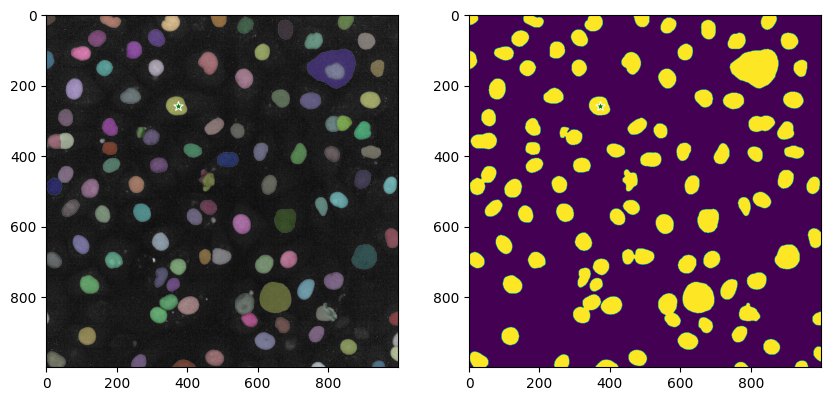

box: [664, 669, 47, 48]
masks_new_auto_result True
[687, 693] is True in new masks


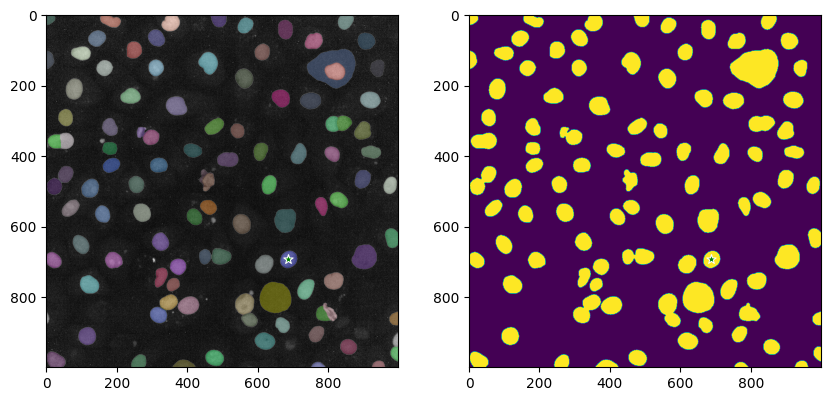

box: [803, 503, 51, 45]
masks_new_auto_result False
[828, 525] is not True in new masks


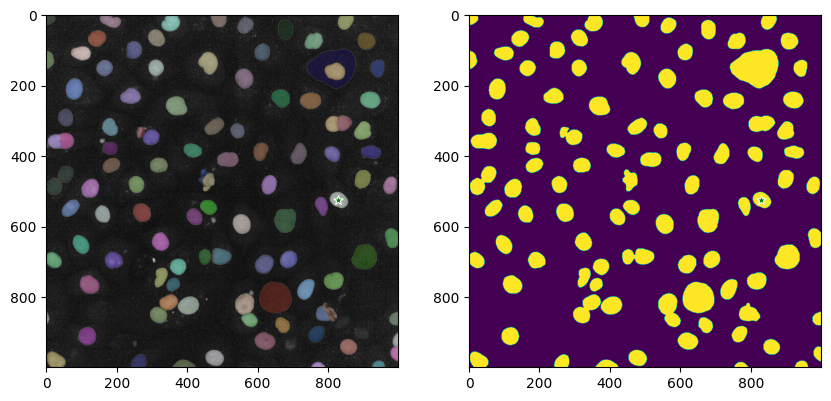

box: [589, 902, 57, 51]
masks_new_auto_result False
[617, 927] is not True in new masks


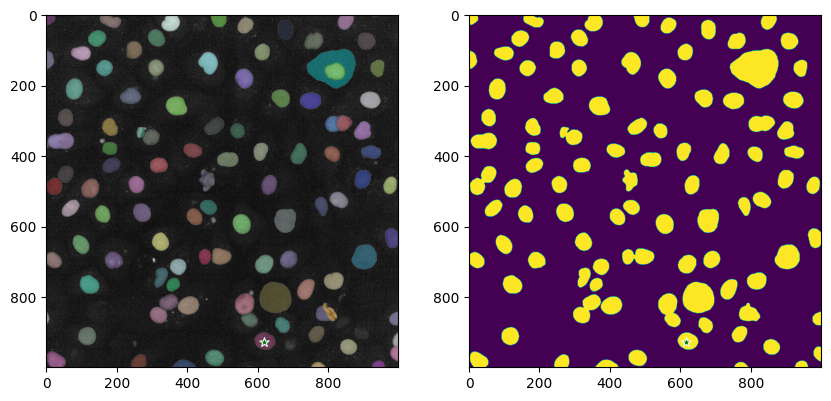

box: [894, 220, 56, 47]
masks_new_auto_result False
[922, 243] is not True in new masks


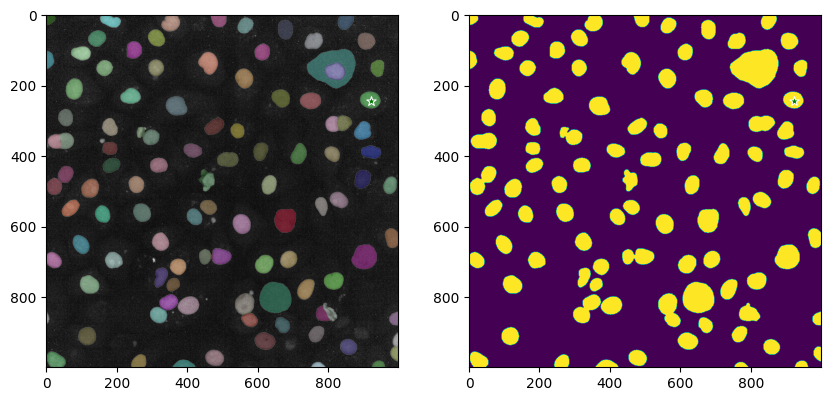

box: [722, 227, 59, 46]
masks_new_auto_result False
[751, 250] is not True in new masks


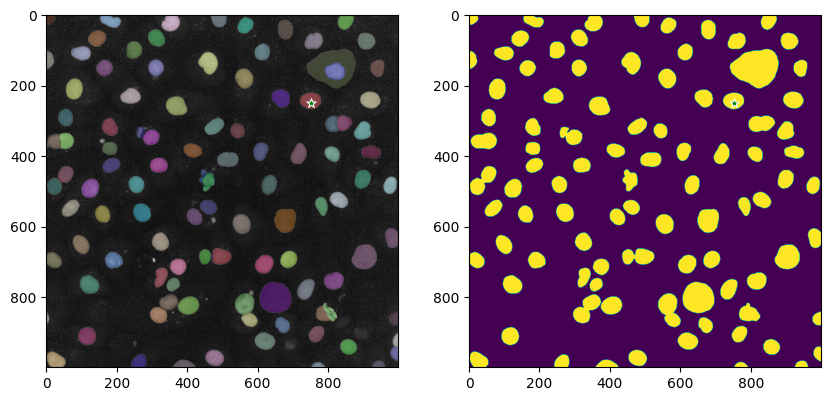

box: [103, 740, 54, 51]
masks_new_auto_result True
[130, 765] is True in new masks


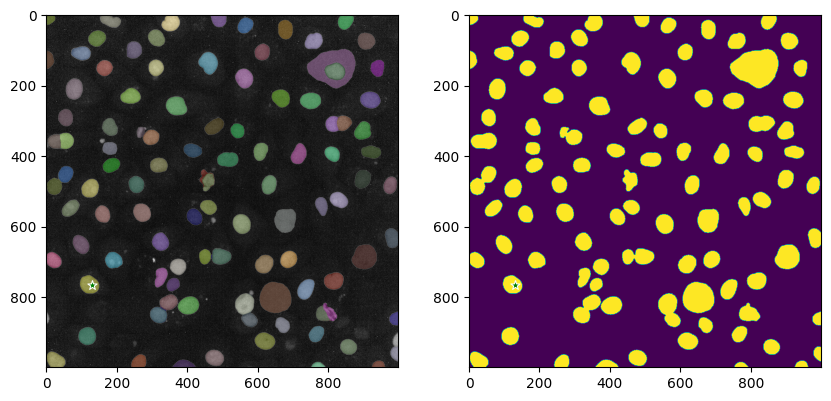

box: [238, 460, 45, 46]
masks_new_auto_result False
[260, 483] is not True in new masks


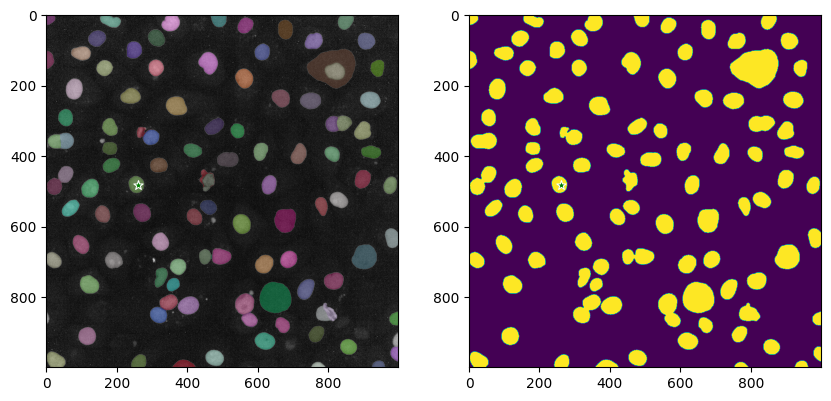

box: [93, 889, 49, 48]
masks_new_auto_result False
[117, 913] is not True in new masks


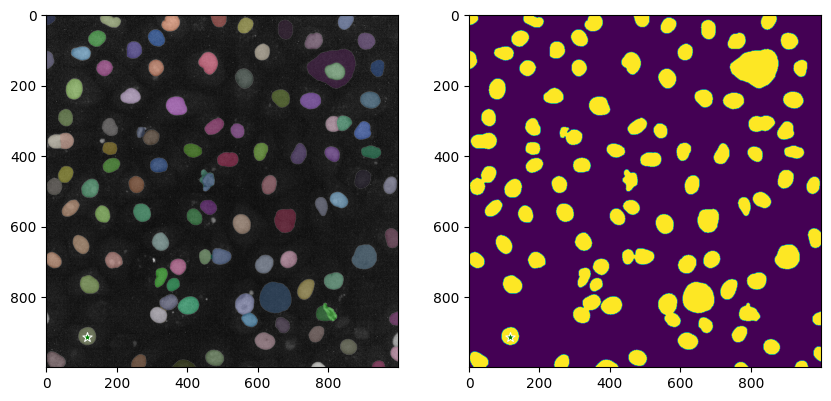

box: [354, 697, 44, 45]
masks_new_auto_result True
[376, 719] is True in new masks


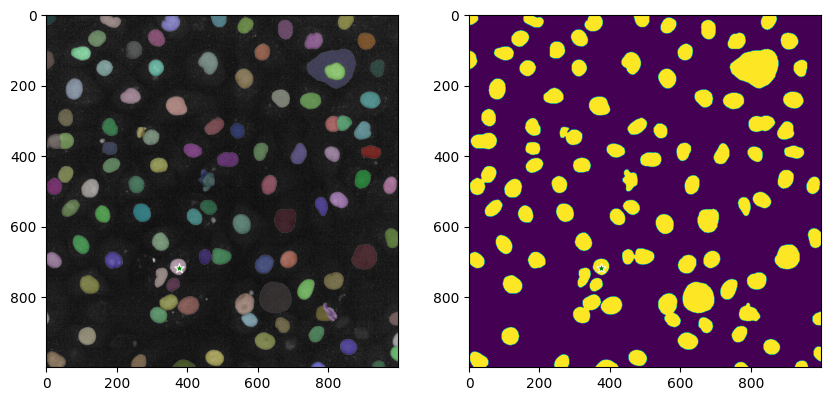

box: [232, 79, 45, 47]
masks_new_auto_result False
[254, 102] is not True in new masks


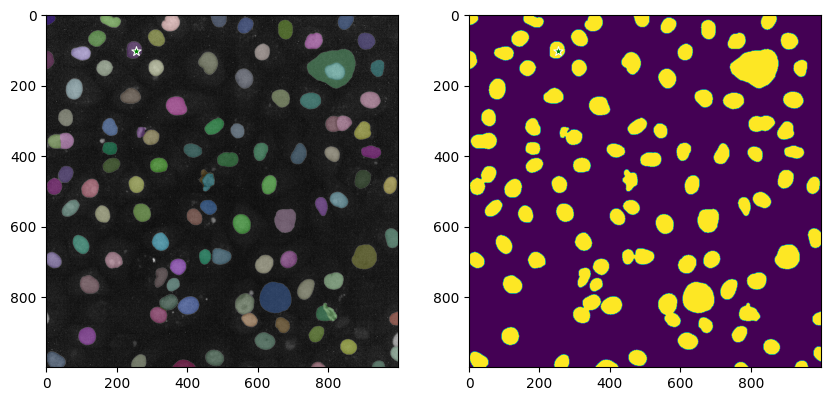

box: [596, 83, 40, 47]
masks_new_auto_result False
[616, 106] is not True in new masks


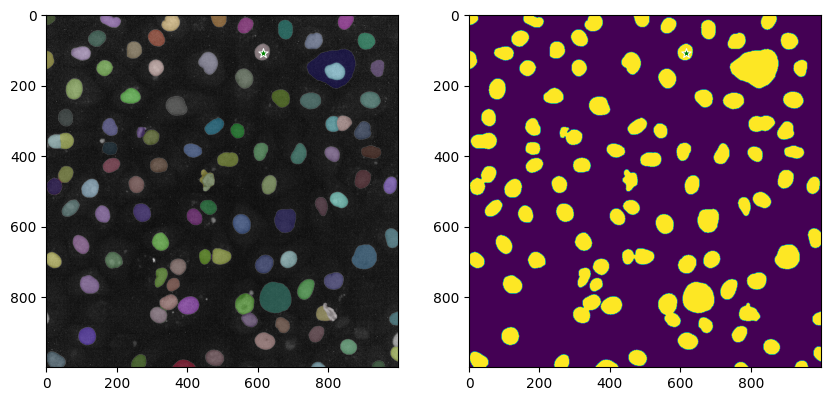

box: [296, 45, 50, 49]
masks_new_auto_result False
[321, 69] is not True in new masks


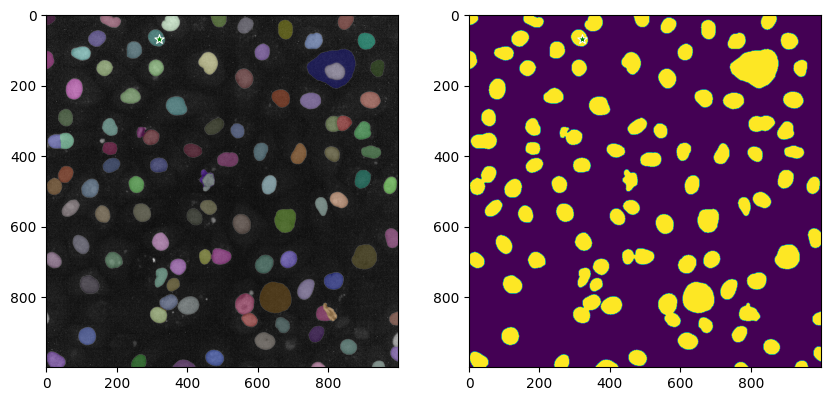

box: [789, 733, 56, 48]
masks_new_auto_result False
[817, 757] is not True in new masks


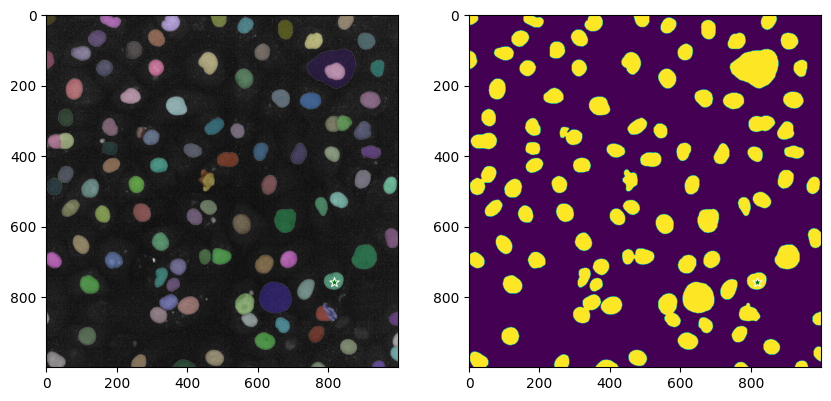

box: [295, 405, 49, 40]
masks_new_auto_result False
[319, 425] is not True in new masks


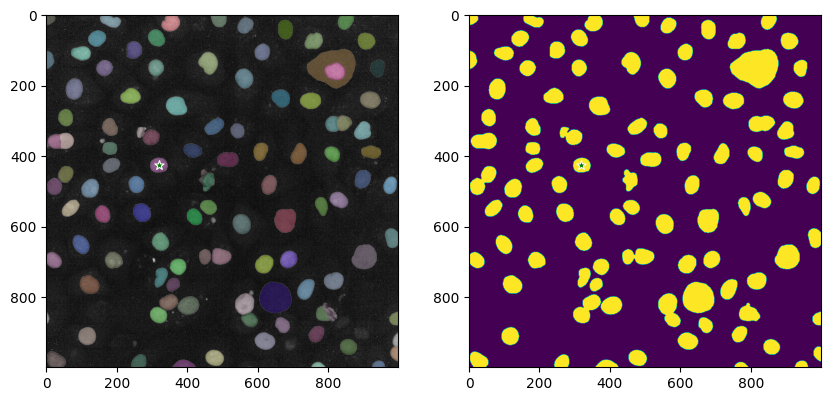

box: [471, 664, 54, 45]
masks_new_auto_result False
[498, 686] is not True in new masks


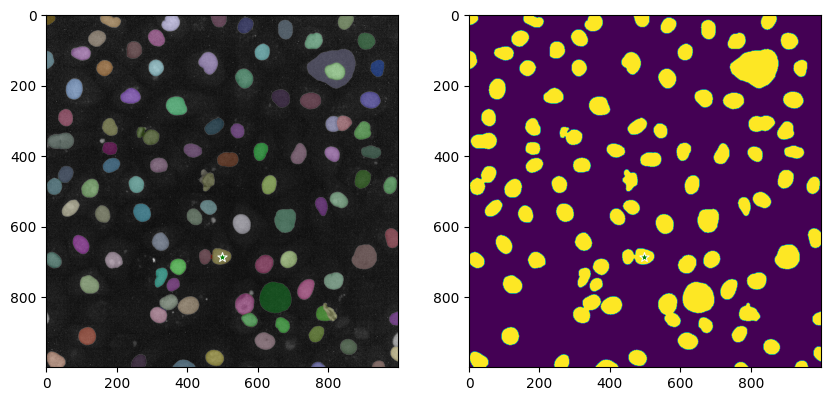

box: [139, 540, 39, 49]
masks_new_auto_result True
[158, 564] is True in new masks


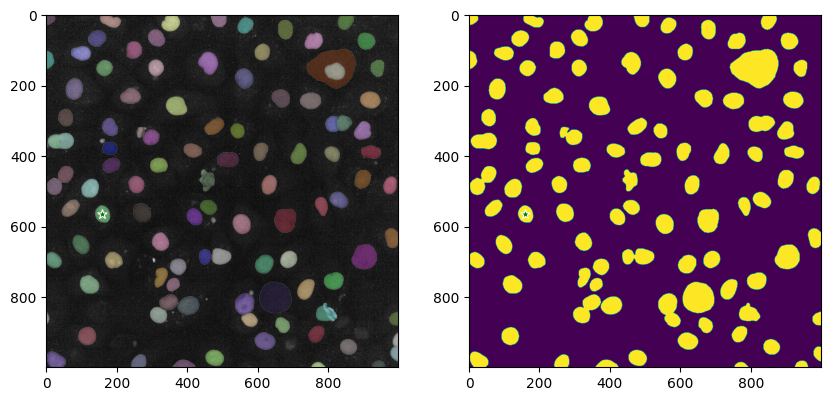

box: [71, 94, 56, 37]
masks_new_auto_result True
[99, 112] is True in new masks


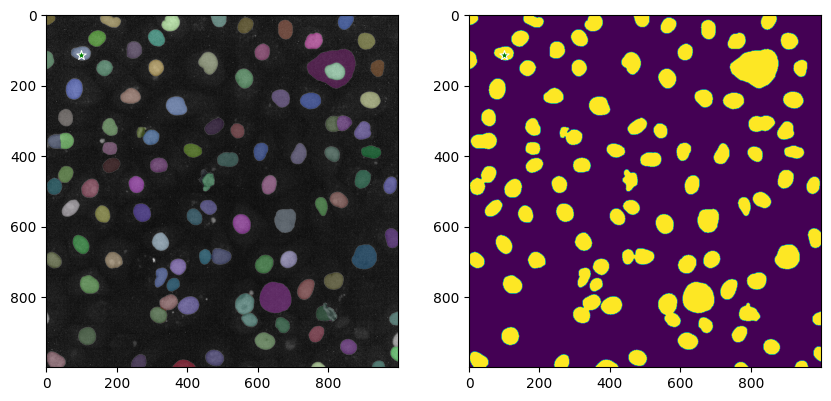

box: [116, 46, 52, 44]
masks_new_auto_result False
[142, 68] is not True in new masks


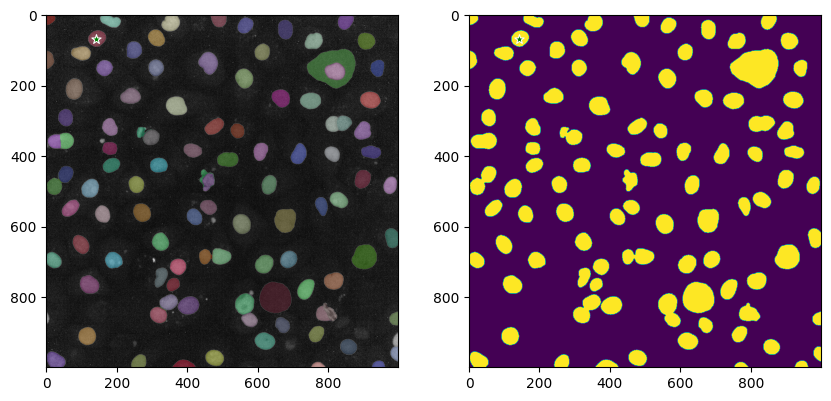

box: [589, 359, 40, 52]
masks_new_auto_result False
[609, 385] is not True in new masks


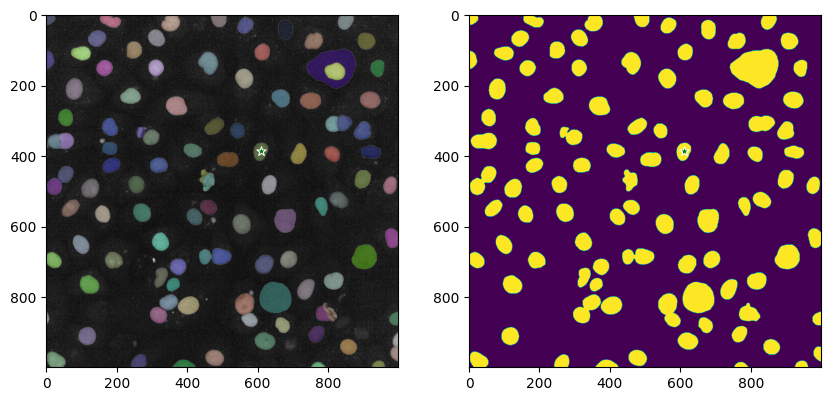

box: [468, 0, 44, 33]
masks_new_auto_result True
[490, 16] is True in new masks


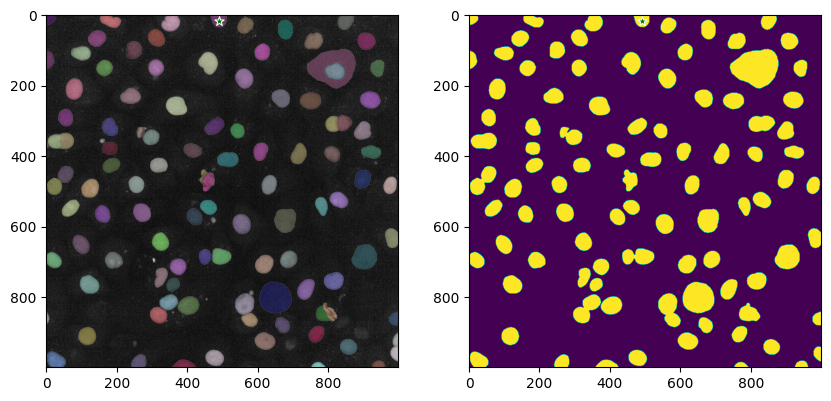

box: [300, 617, 48, 49]
masks_new_auto_result False
[324, 641] is not True in new masks


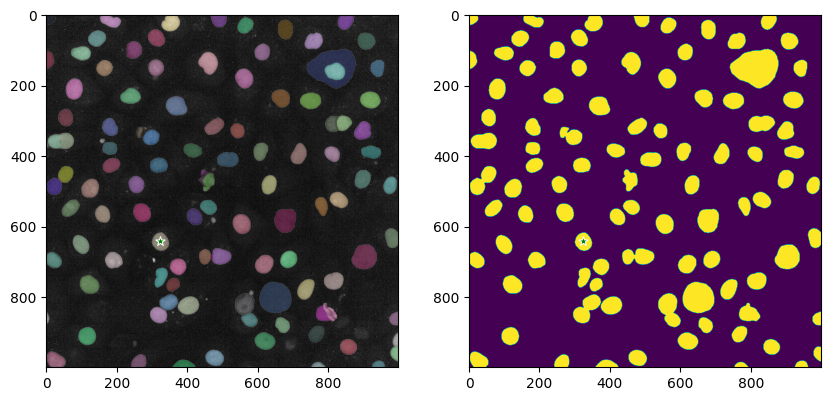

box: [49, 529, 51, 46]
masks_new_auto_result False
[74, 552] is not True in new masks


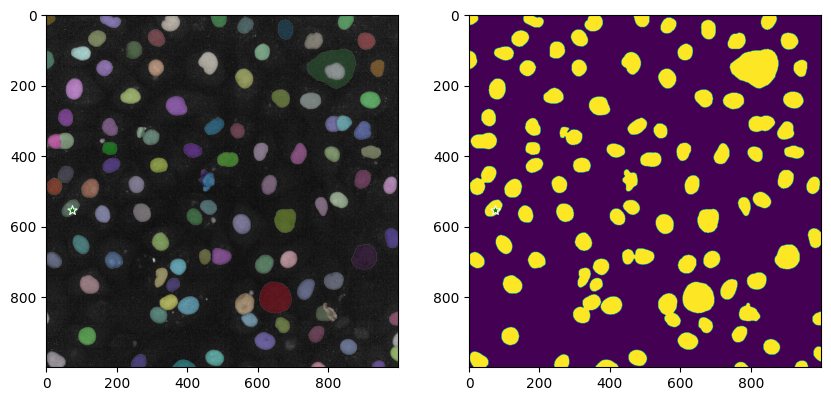

box: [144, 131, 46, 42]
masks_new_auto_result True
[167, 152] is True in new masks


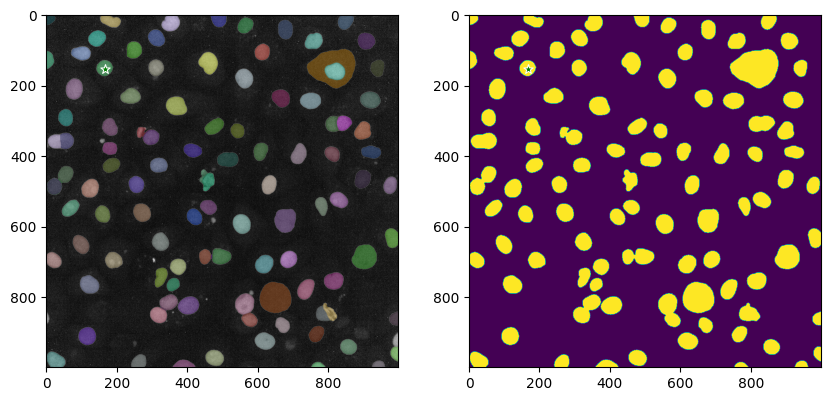

box: [239, 966, 40, 33]
masks_new_auto_result False
[259, 982] is not True in new masks


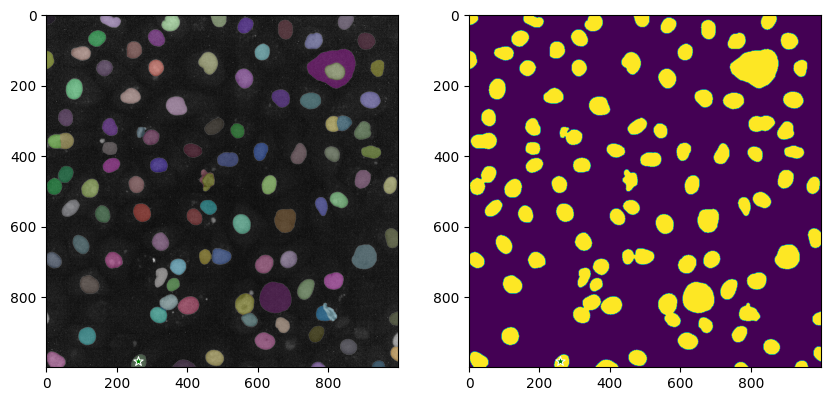

box: [35, 268, 41, 48]
masks_new_auto_result True
[55, 292] is True in new masks


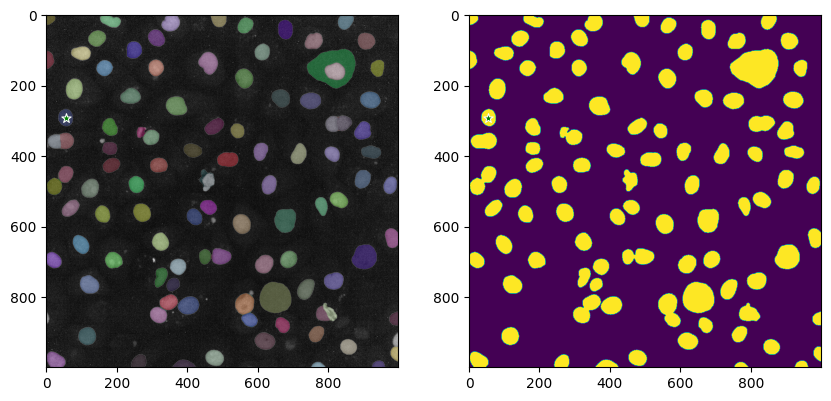

box: [391, 557, 44, 45]
masks_new_auto_result False
[413, 579] is not True in new masks


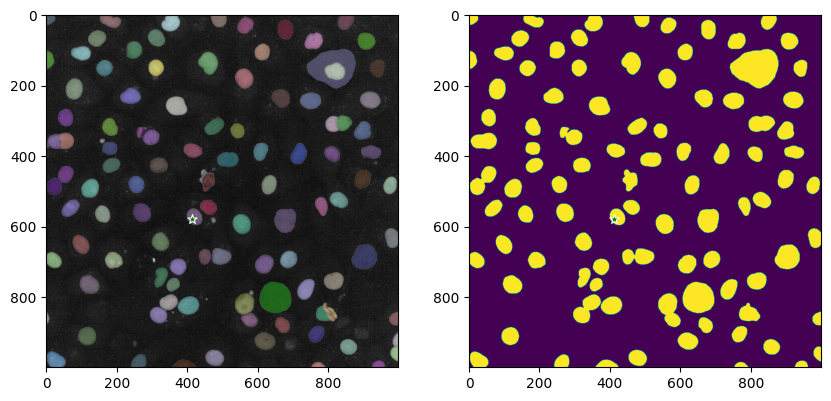

box: [531, 563, 49, 56]
masks_new_auto_result False
[555, 591] is not True in new masks


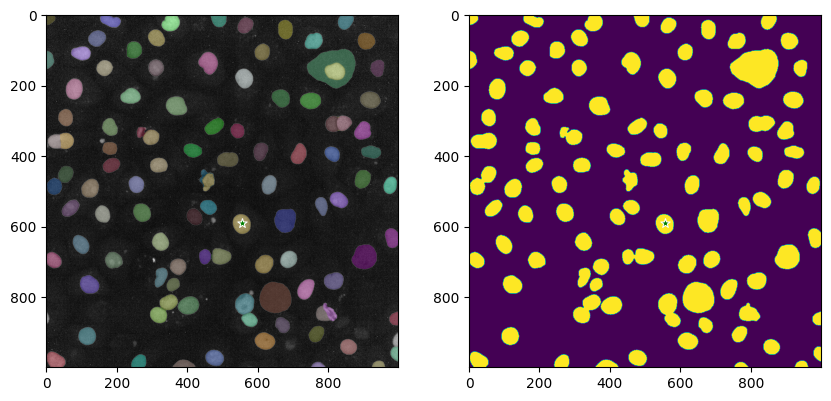

box: [60, 183, 47, 59]
masks_new_auto_result False
[83, 212] is not True in new masks


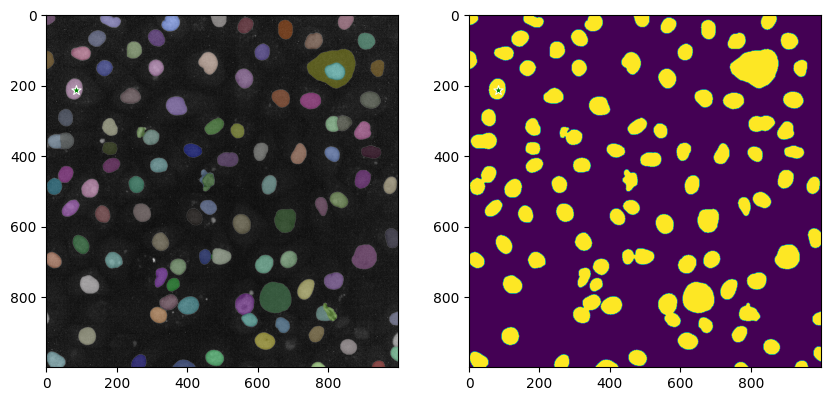

box: [791, 372, 43, 44]
masks_new_auto_result True
[812, 394] is True in new masks


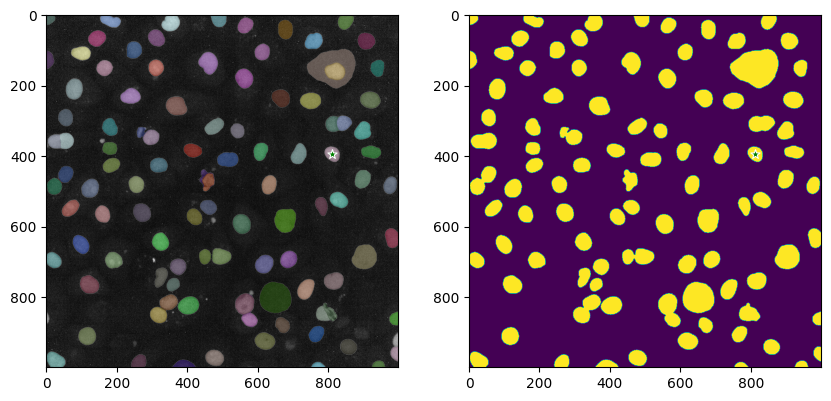

box: [790, 140, 57, 48]
masks_new_auto_result False
[818, 164] is not True in new masks


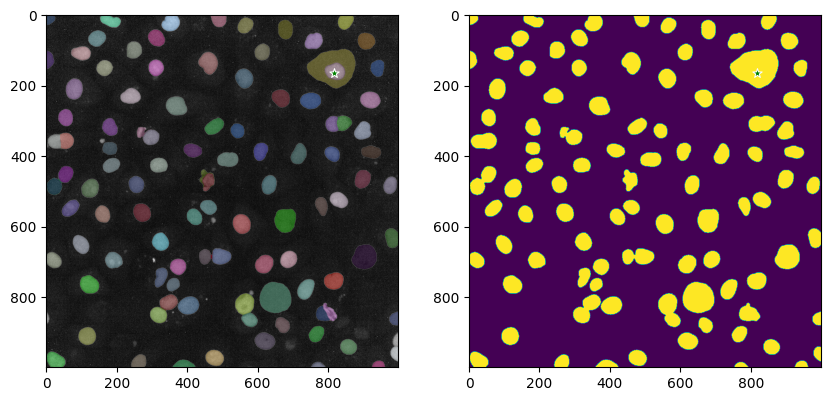

box: [739, 53, 50, 44]
masks_new_auto_result False
[764, 75] is not True in new masks


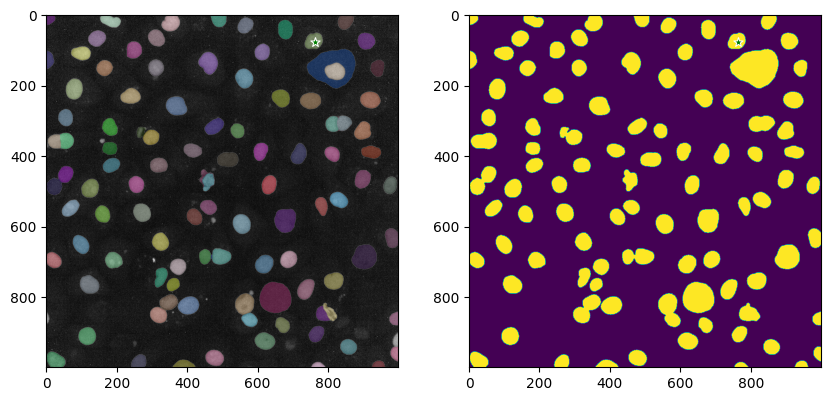

box: [153, 295, 44, 50]
masks_new_auto_result False
[175, 320] is not True in new masks


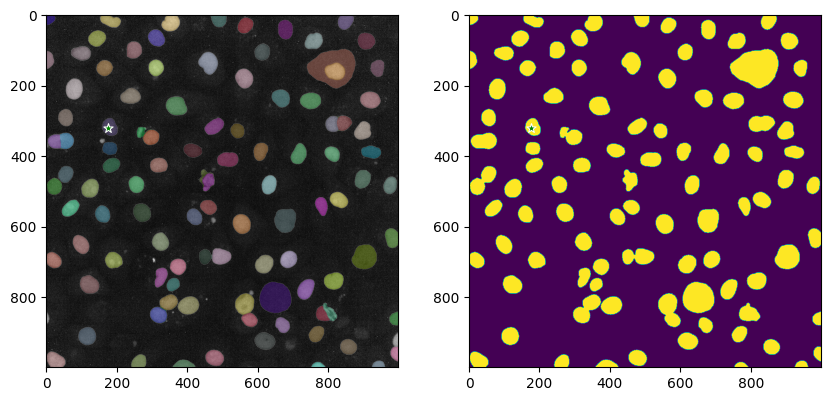

box: [797, 287, 75, 46]
masks_new_auto_result True
[834, 310] is True in new masks


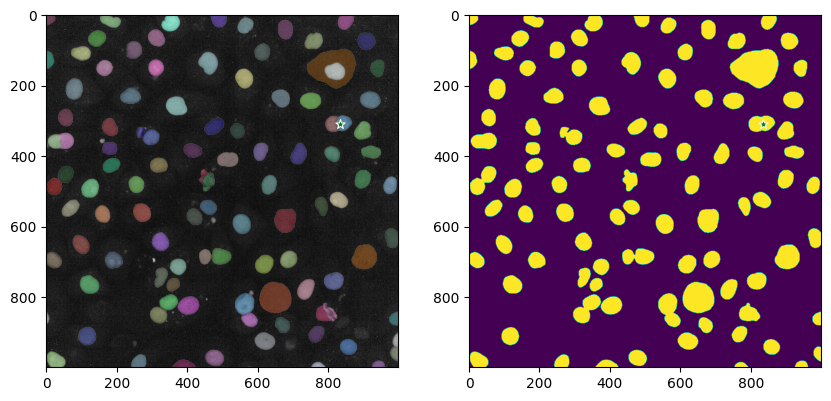

box: [77, 630, 49, 50]
masks_new_auto_result False
[101, 655] is not True in new masks


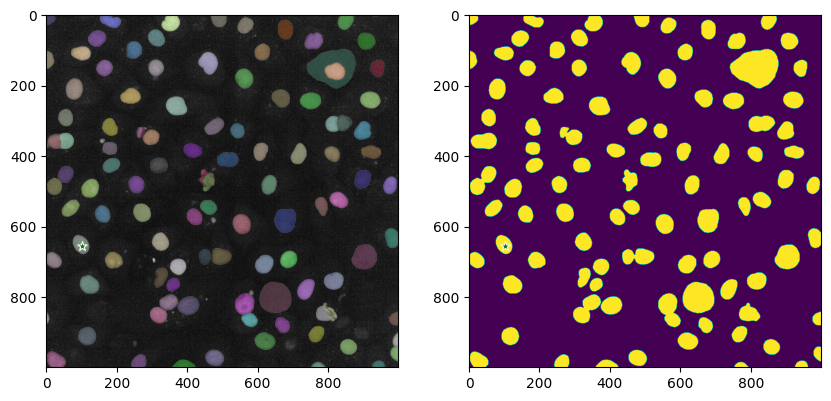

box: [172, 671, 48, 44]
masks_new_auto_result False
[196, 693] is not True in new masks


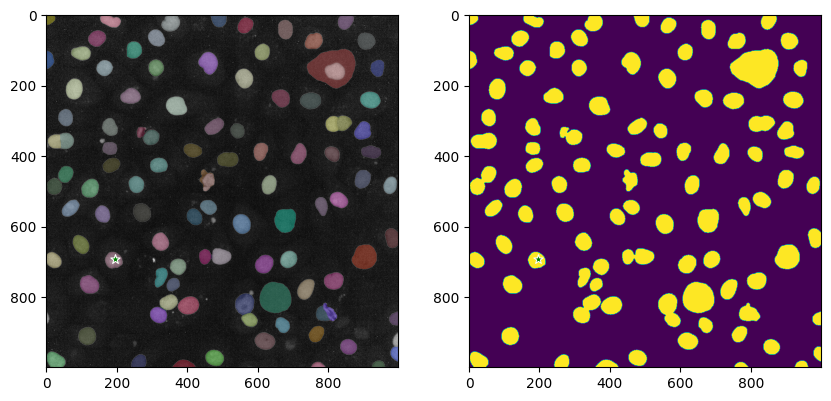

box: [216, 211, 55, 45]
masks_new_auto_result True
[243, 233] is True in new masks


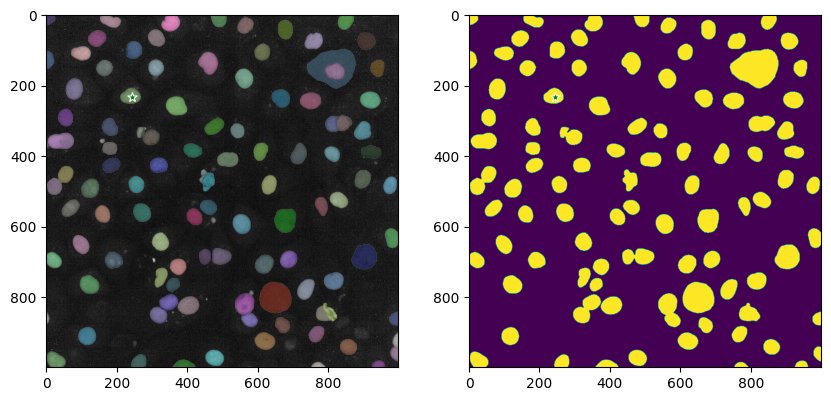

box: [832, 924, 47, 42]
masks_new_auto_result False
[855, 945] is not True in new masks


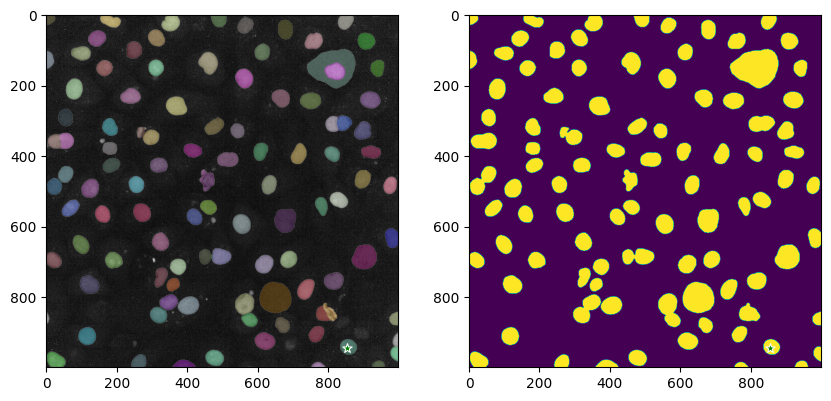

box: [649, 550, 61, 68]
masks_new_auto_result False
[679, 584] is not True in new masks


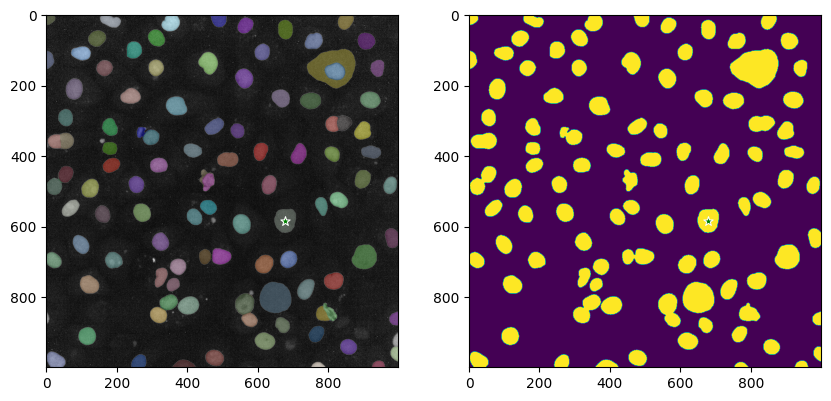

box: [4, 466, 42, 49]
masks_new_auto_result True
[25, 490] is True in new masks


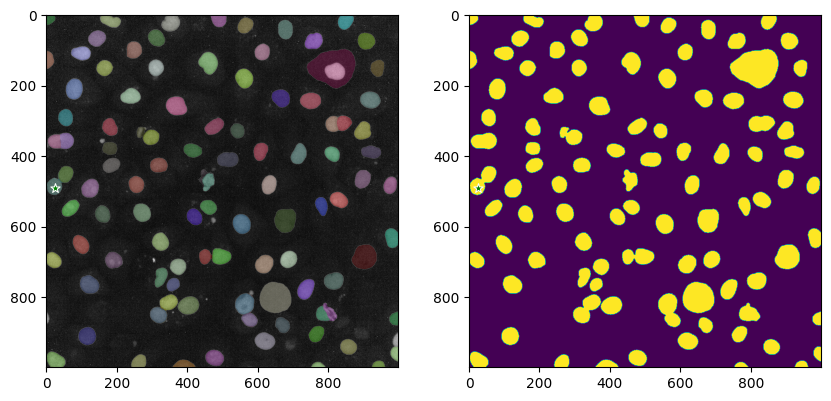

box: [0, 671, 42, 44]
masks_new_auto_result False
[21, 693] is not True in new masks


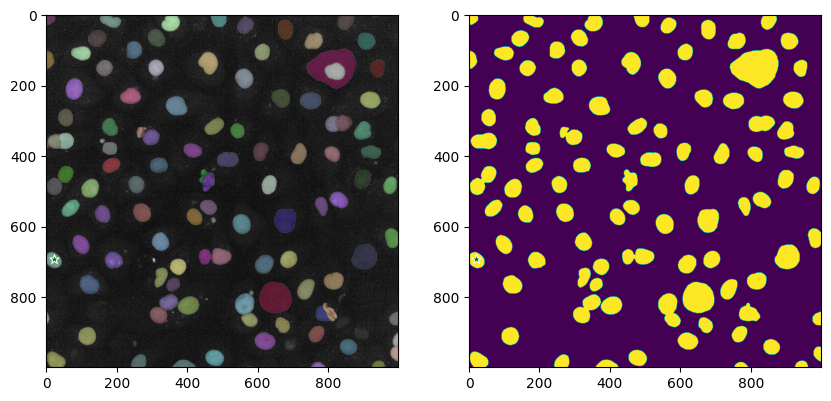

box: [543, 151, 51, 54]
masks_new_auto_result True
[568, 178] is True in new masks


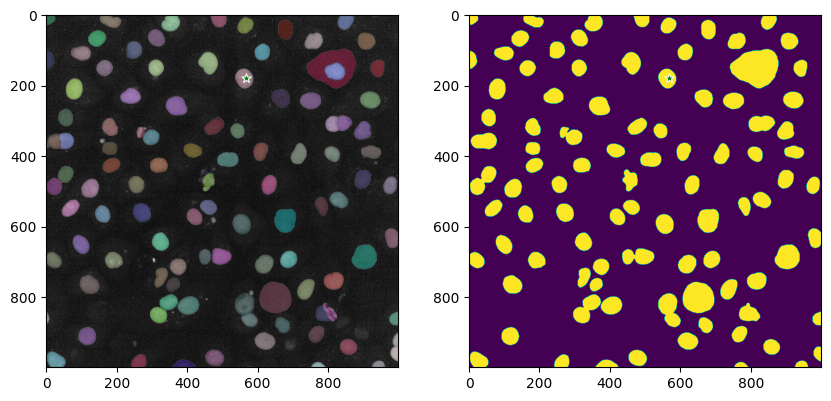

box: [0, 100, 25, 50]
masks_new_auto_result False
[12, 125] is not True in new masks


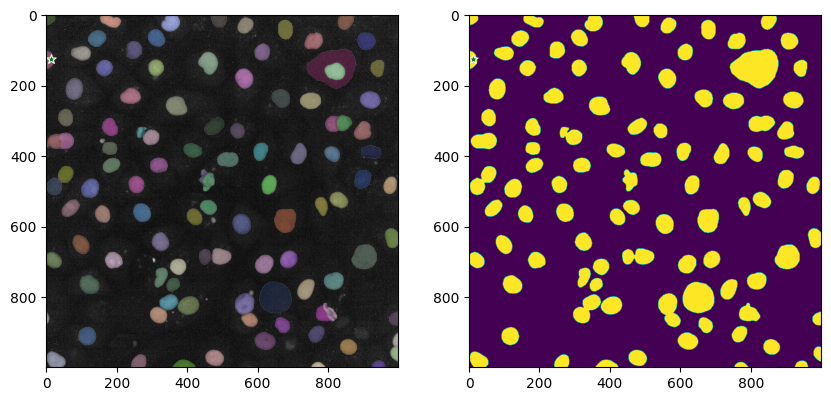

box: [549, 8, 46, 44]
masks_new_auto_result False
[572, 30] is not True in new masks


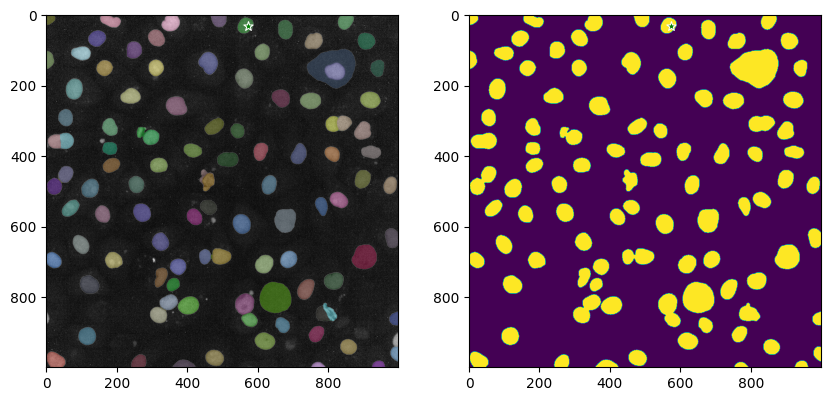

box: [966, 612, 33, 53]
masks_new_auto_result False
[982, 638] is not True in new masks


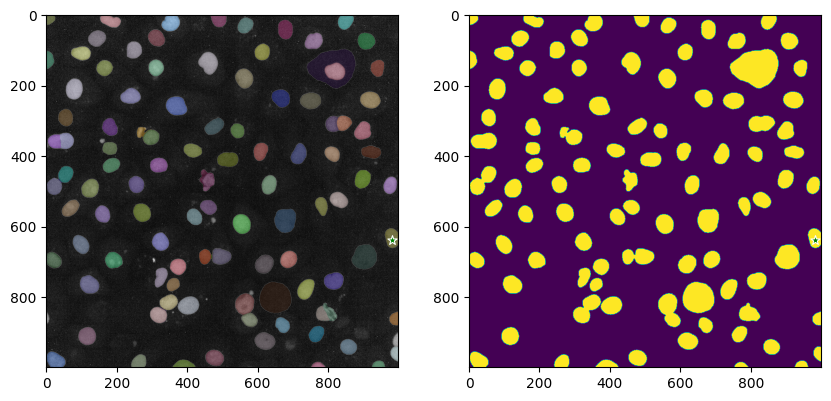

box: [827, 287, 45, 42]
masks_new_auto_result True
[849, 308] is True in new masks


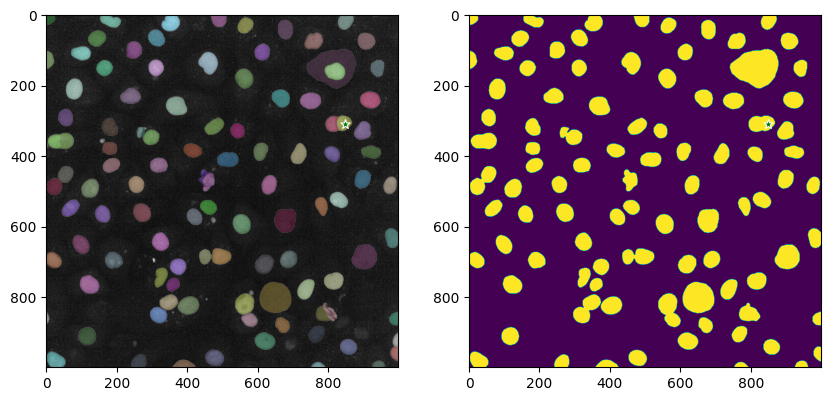

box: [886, 56, 46, 46]
masks_new_auto_result False
[909, 79] is not True in new masks


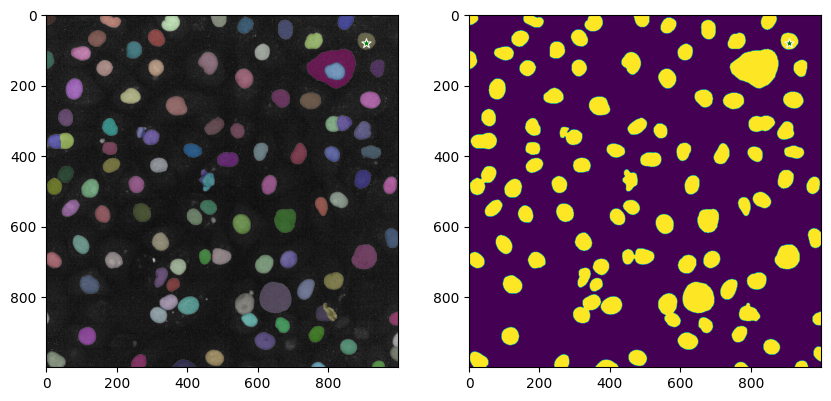

box: [434, 530, 47, 42]
masks_new_auto_result False
[457, 551] is not True in new masks


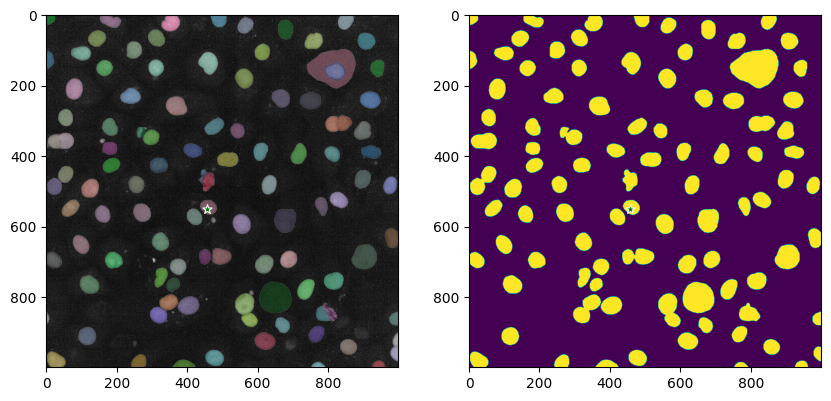

box: [36, 433, 44, 45]
masks_new_auto_result False
[58, 455] is not True in new masks


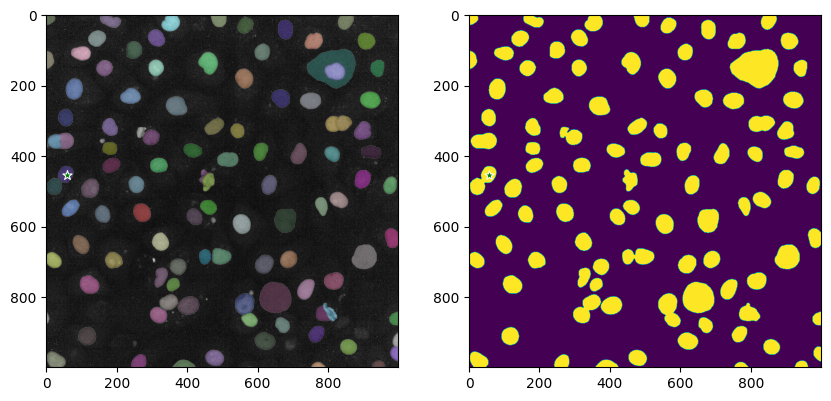

box: [324, 794, 51, 44]
masks_new_auto_result False
[349, 816] is not True in new masks


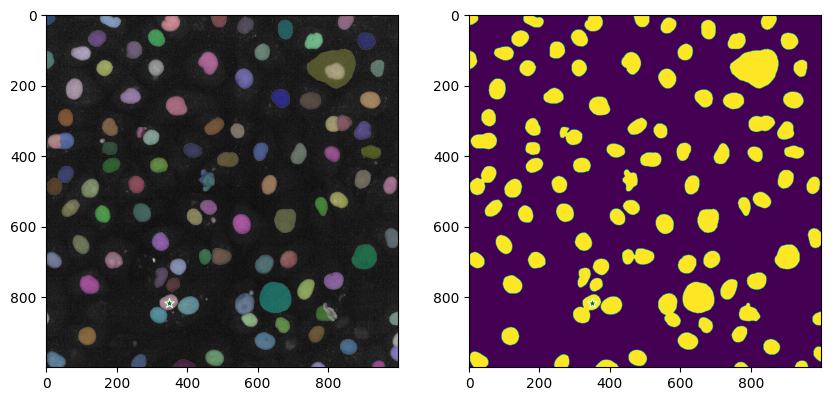

box: [642, 216, 52, 50]
masks_new_auto_result False
[668, 241] is not True in new masks


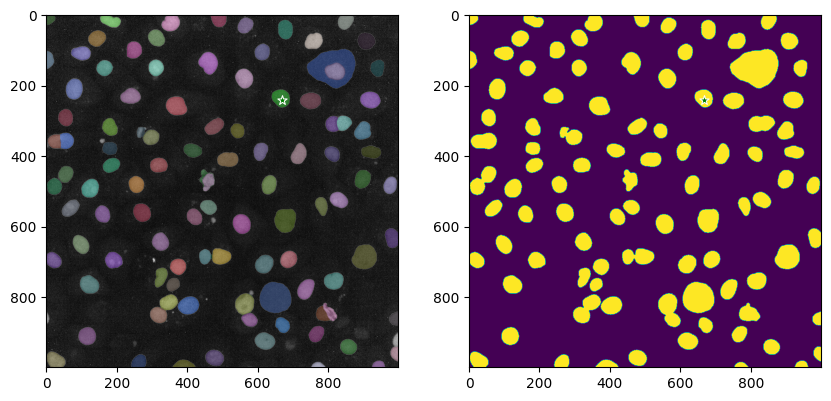

box: [439, 106, 53, 63]
masks_new_auto_result False
[465, 137] is not True in new masks


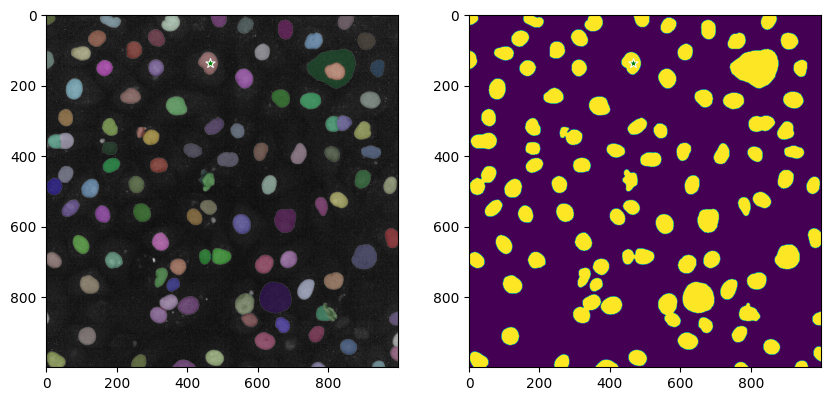

box: [299, 832, 47, 46]
masks_new_auto_result True
[322, 855] is True in new masks


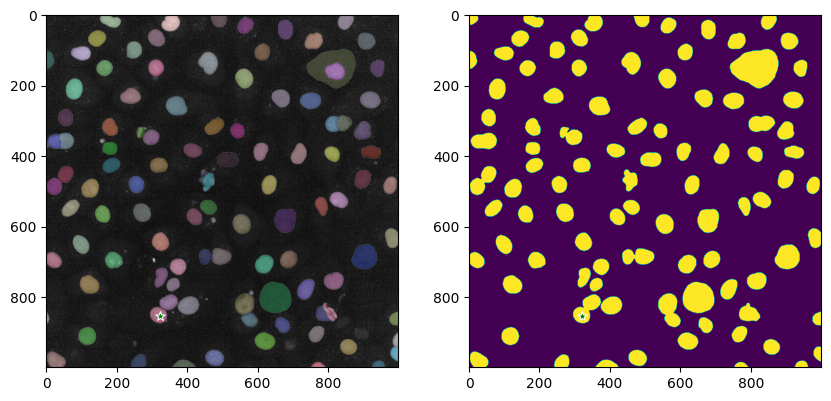

box: [832, 0, 45, 41]
masks_new_auto_result False
[854, 20] is not True in new masks


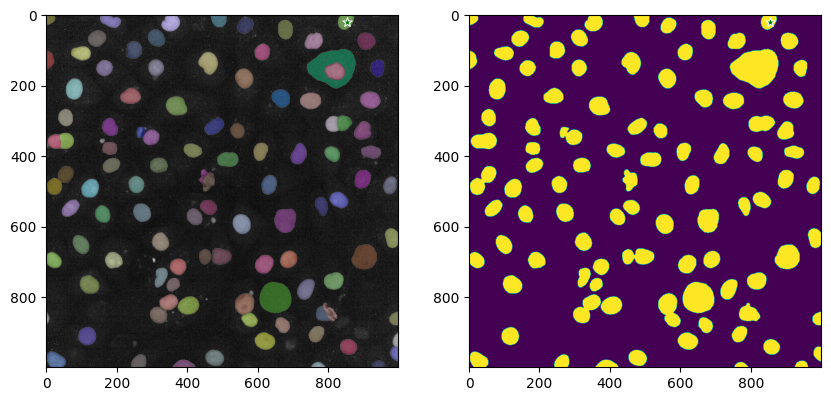

box: [3, 433, 77, 82]
masks_new_auto_result False
[41, 474] is not True in new masks


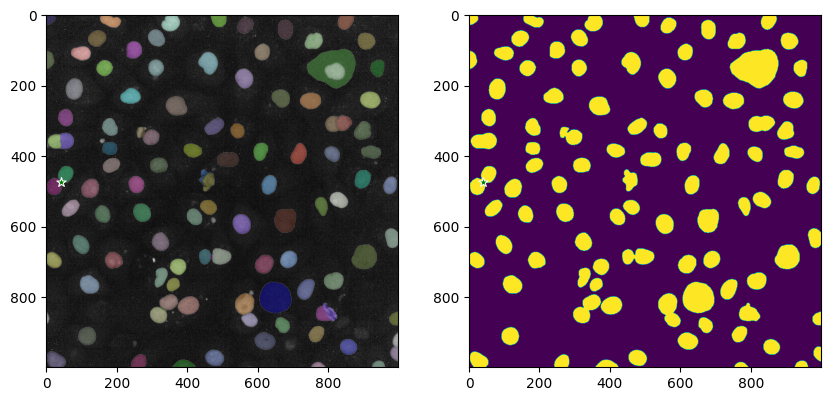

box: [162, 414, 46, 42]
masks_new_auto_result False
[185, 435] is not True in new masks


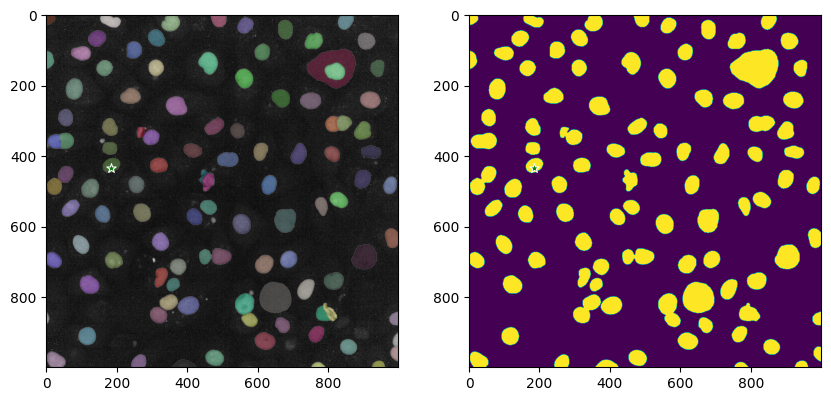

box: [278, 328, 47, 39]
masks_new_auto_result False
[301, 347] is not True in new masks


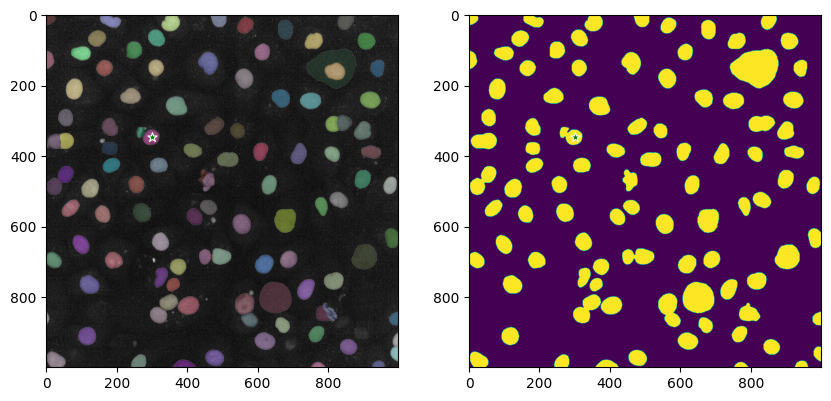

box: [488, 387, 60, 43]
masks_new_auto_result False
[518, 408] is not True in new masks


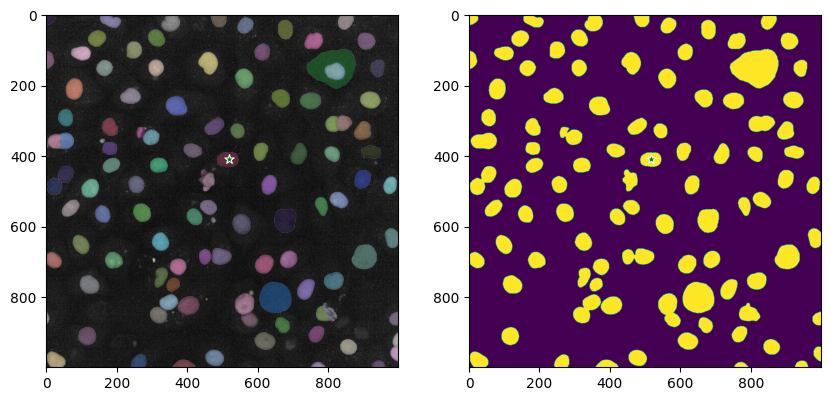

box: [536, 791, 53, 59]
masks_new_auto_result False
[562, 820] is not True in new masks


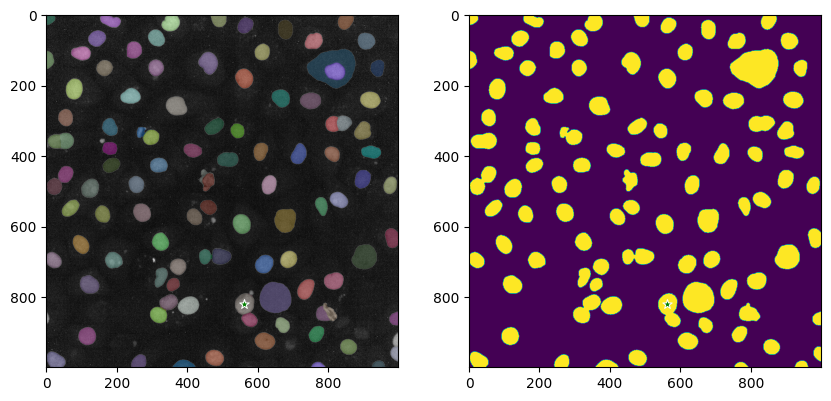

box: [439, 659, 86, 50]
masks_new_auto_result False
[482, 684] is not True in new masks


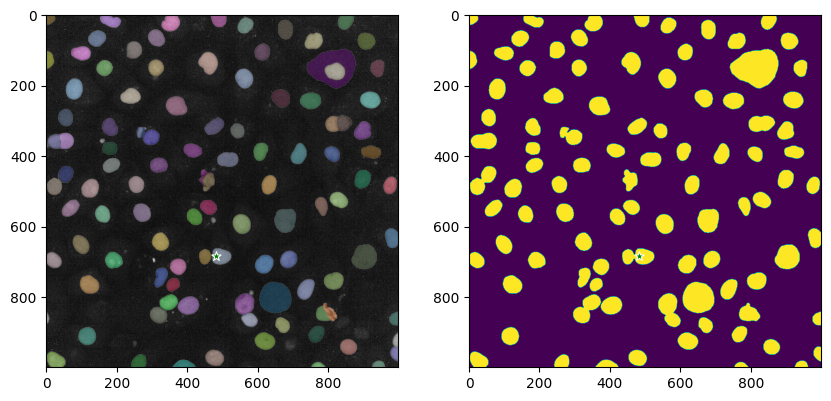

box: [695, 369, 46, 58]
masks_new_auto_result False
[718, 398] is not True in new masks


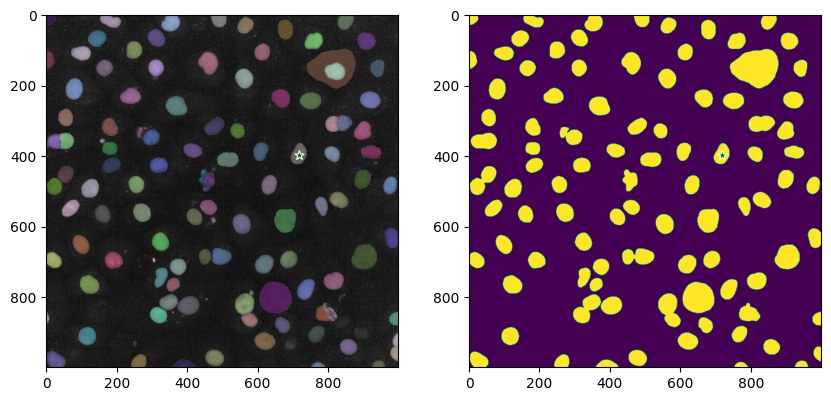

box: [766, 516, 33, 52]
masks_new_auto_result False
[782, 542] is not True in new masks


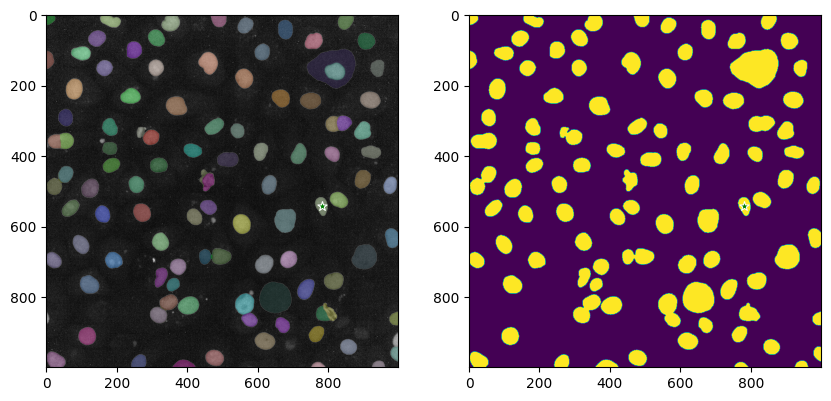

box: [876, 442, 44, 54]
masks_new_auto_result False
[898, 469] is not True in new masks


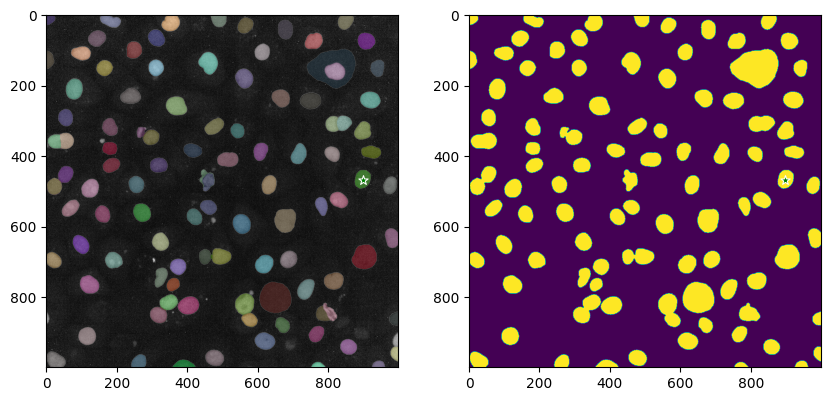

box: [526, 307, 37, 41]
masks_new_auto_result False
[544, 327] is not True in new masks


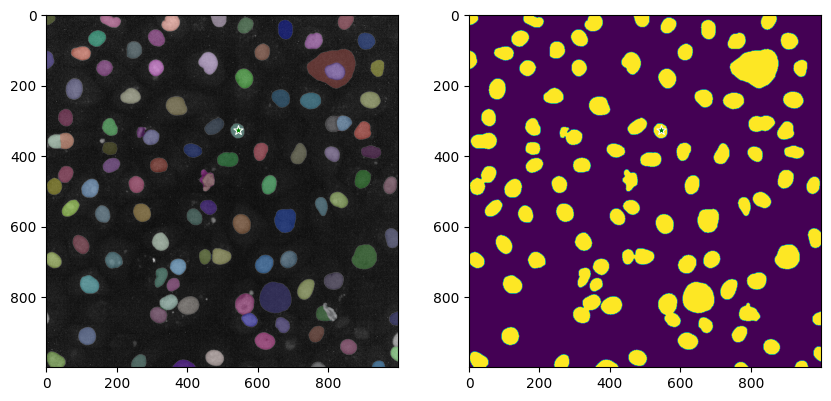

box: [41, 336, 40, 45]
masks_new_auto_result False
[61, 358] is not True in new masks


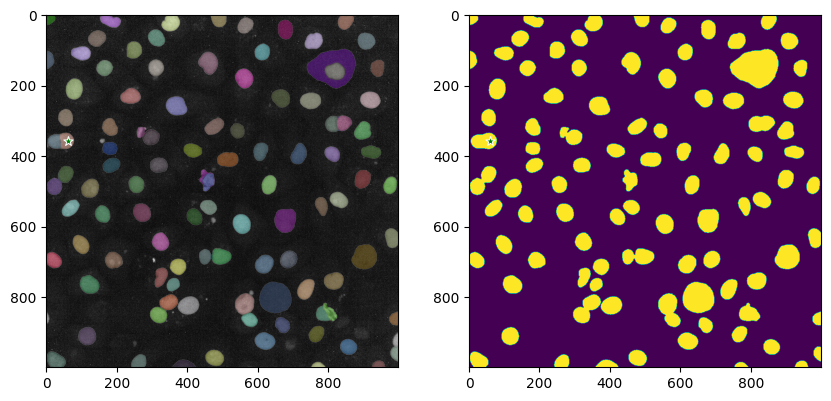

box: [438, 659, 32, 42]
masks_new_auto_result False
[454, 680] is not True in new masks


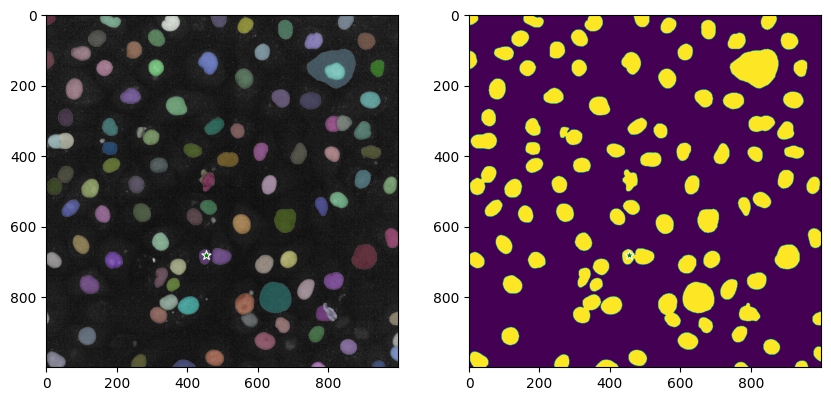

box: [655, 858, 39, 45]
masks_new_auto_result True
[674, 880] is True in new masks


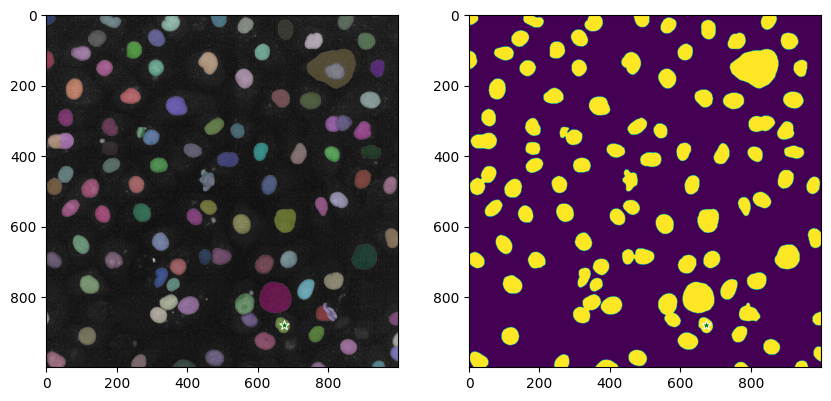

box: [556, 844, 44, 40]
masks_new_auto_result False
[578, 864] is not True in new masks


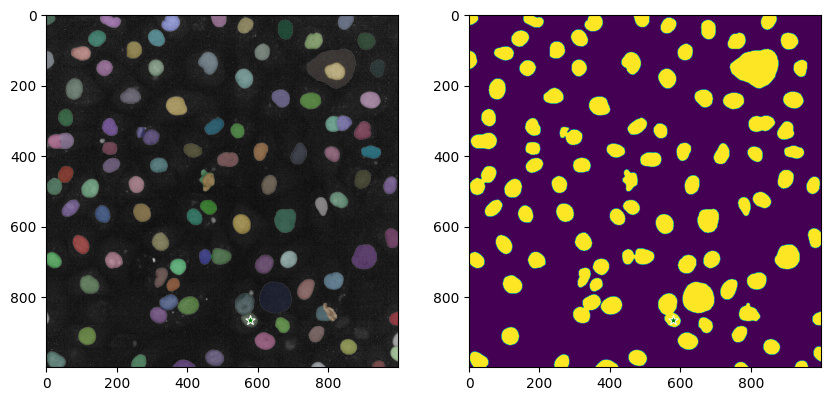

box: [388, 364, 50, 39]
masks_new_auto_result False
[413, 383] is not True in new masks


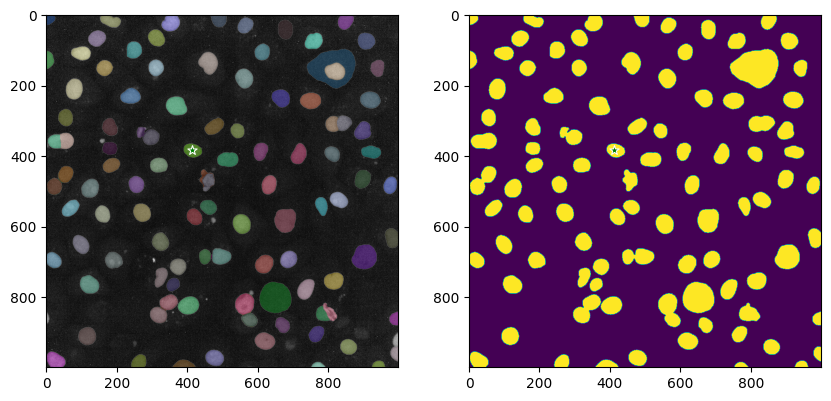

box: [453, 293, 55, 47]
masks_new_auto_result False
[480, 316] is not True in new masks


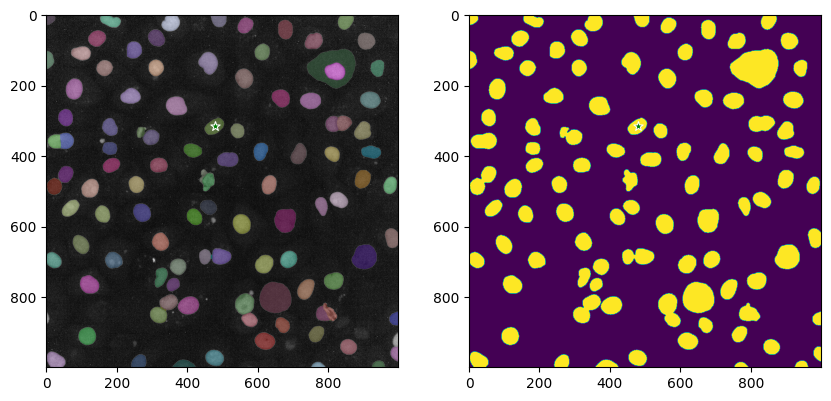

box: [344, 750, 36, 37]
masks_new_auto_result False
[362, 768] is not True in new masks


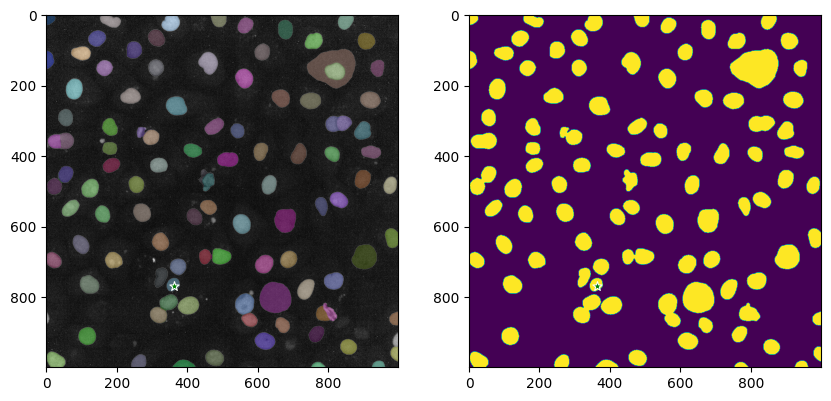

box: [893, 370, 57, 36]
masks_new_auto_result False
[921, 388] is not True in new masks


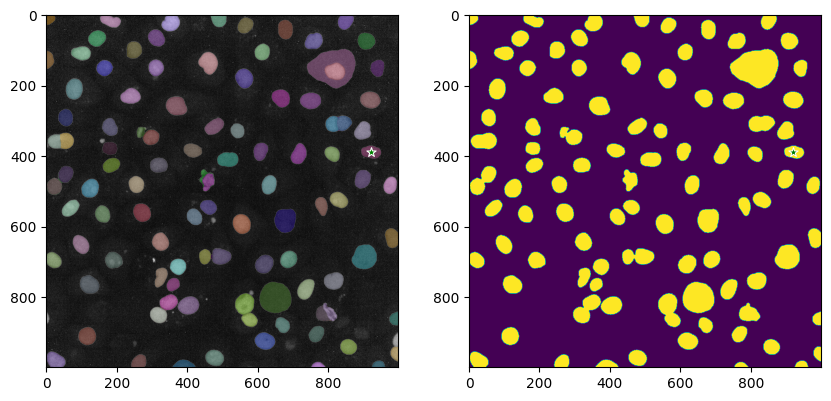

box: [536, 791, 64, 93]
masks_new_auto_result False
[568, 837] is not True in new masks


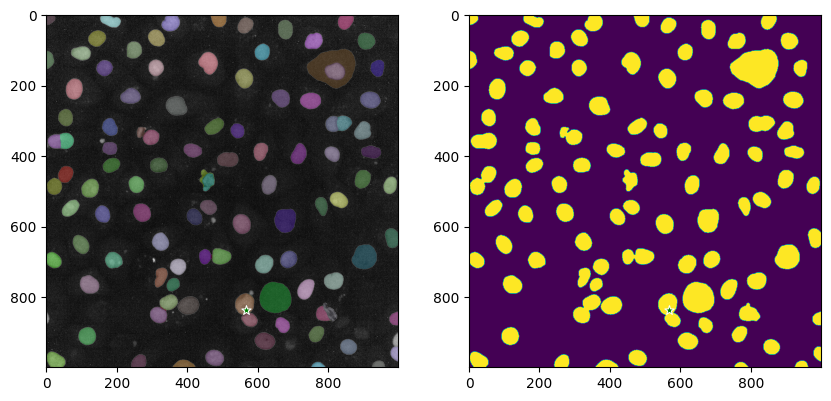

box: [923, 980, 38, 19]
masks_new_auto_result True
[942, 989] is True in new masks


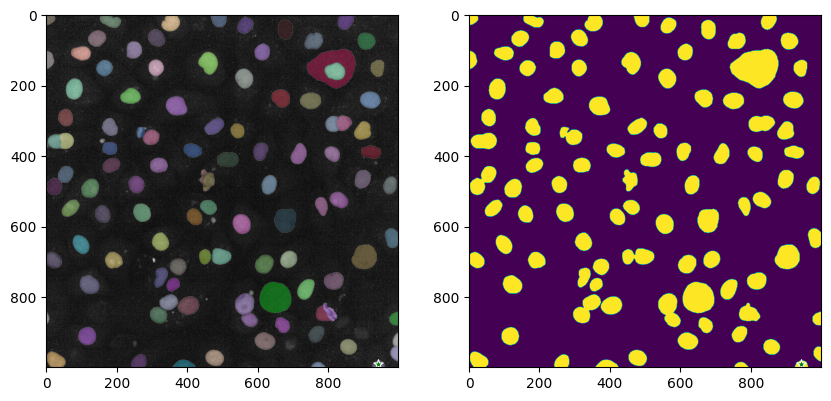

box: [608, 759, 92, 88]
masks_new_auto_result False
[654, 803] is not True in new masks


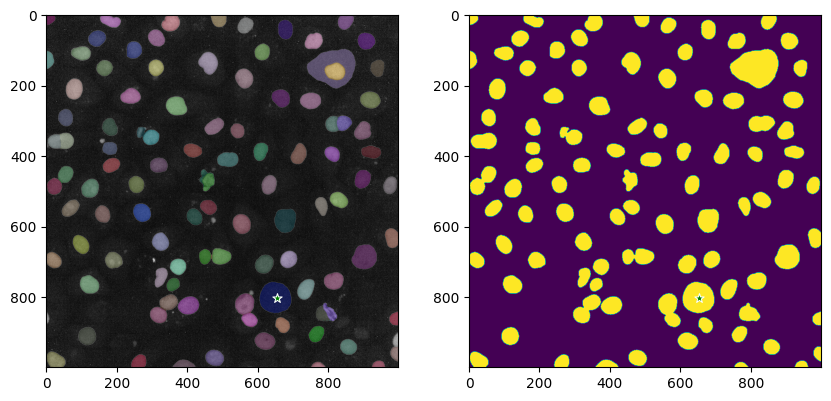

box: [744, 884, 43, 45]
masks_new_auto_result False
[765, 906] is not True in new masks


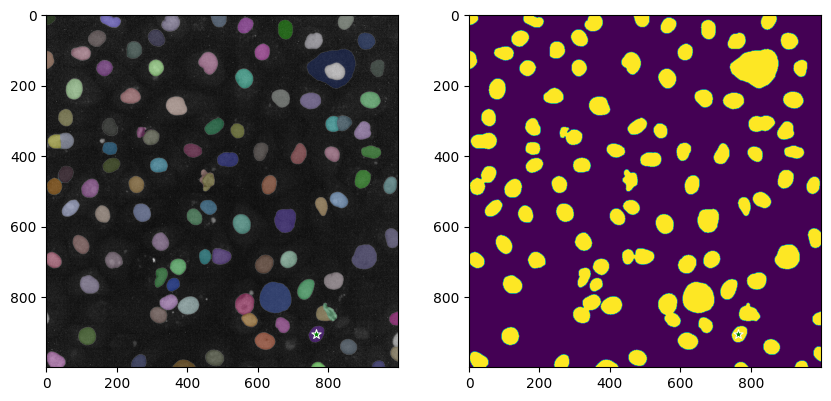

box: [364, 981, 68, 18]
masks_new_auto_result False
[398, 990] is not True in new masks


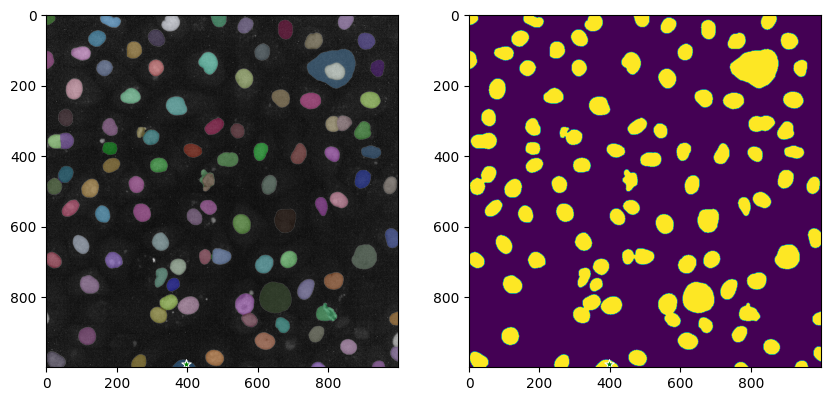

box: [797, 289, 36, 44]
masks_new_auto_result False
[815, 311] is not True in new masks


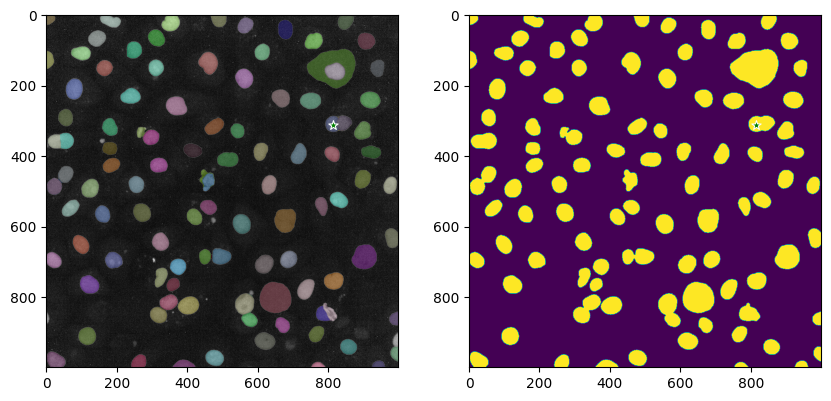

box: [312, 707, 37, 58]
masks_new_auto_result False
[330, 736] is not True in new masks


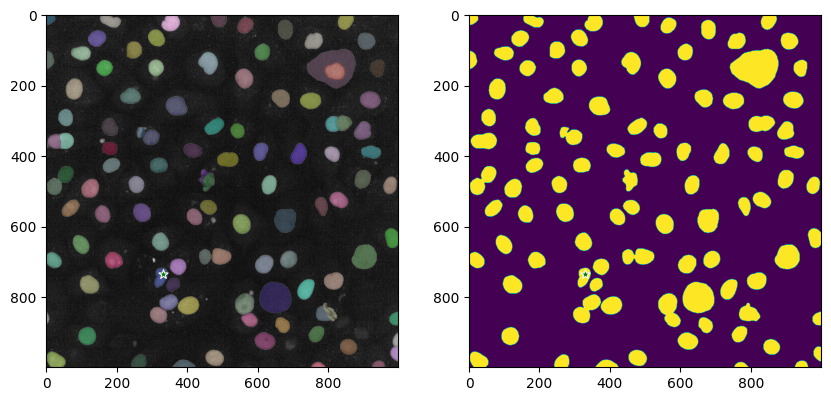

box: [972, 846, 27, 36]
masks_new_auto_result False
[985, 864] is not True in new masks


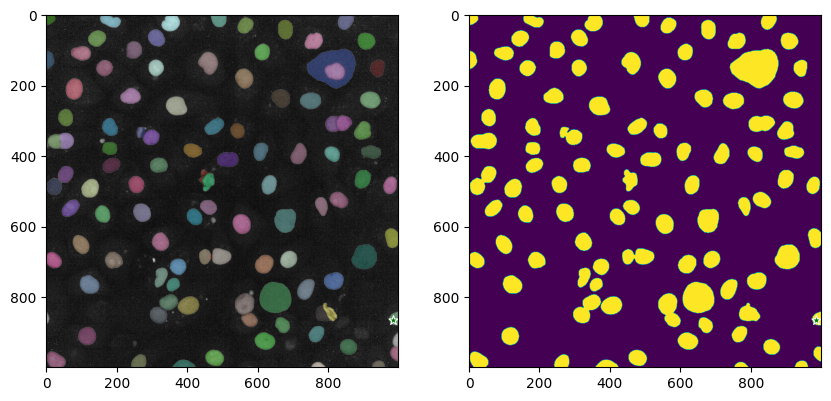

box: [961, 458, 38, 74]
masks_new_auto_result True
[980, 495] is True in new masks


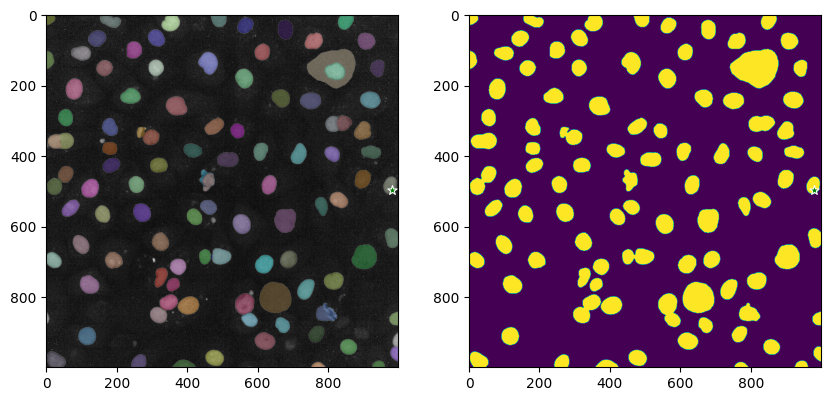

box: [919, 129, 37, 45]
masks_new_auto_result False
[937, 151] is not True in new masks


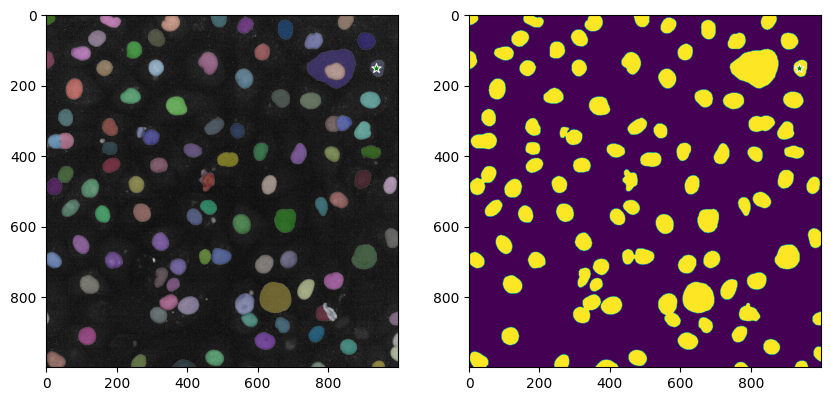

box: [870, 650, 71, 70]
masks_new_auto_result False
[905, 685] is not True in new masks


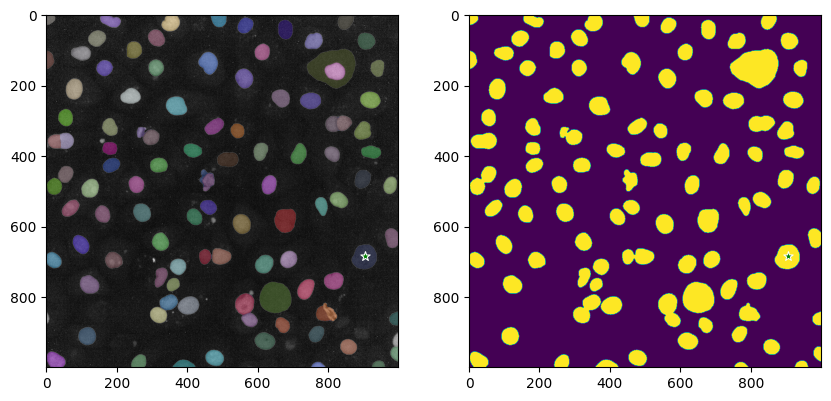

box: [775, 827, 38, 42]
masks_new_auto_result False
[794, 848] is not True in new masks


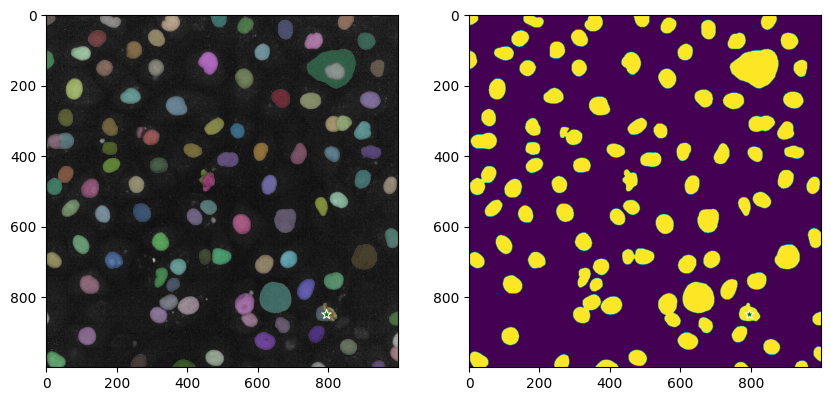

box: [259, 314, 66, 54]
masks_new_auto_result False
[292, 341] is not True in new masks


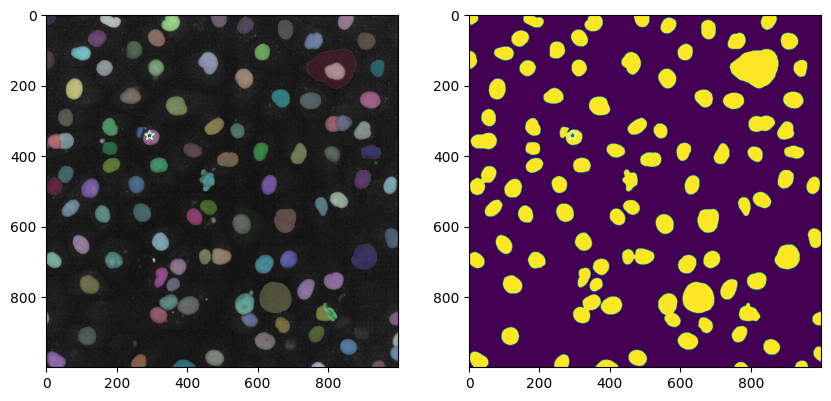

box: [776, 818, 59, 51]
masks_new_auto_result False
[805, 843] is not True in new masks


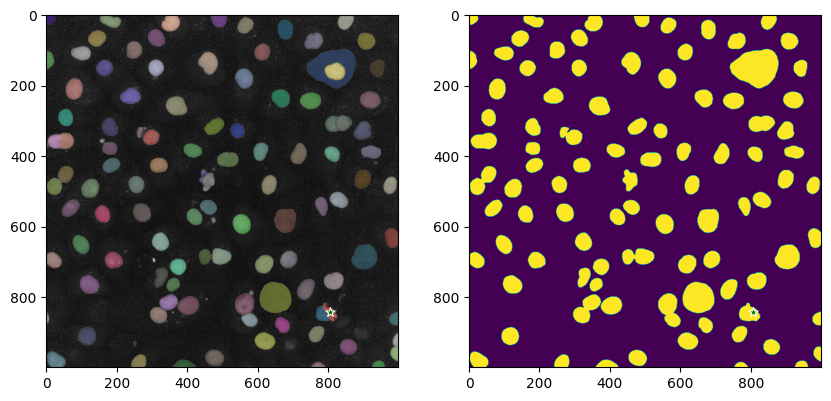

box: [168, 364, 43, 36]
masks_new_auto_result False
[189, 382] is not True in new masks


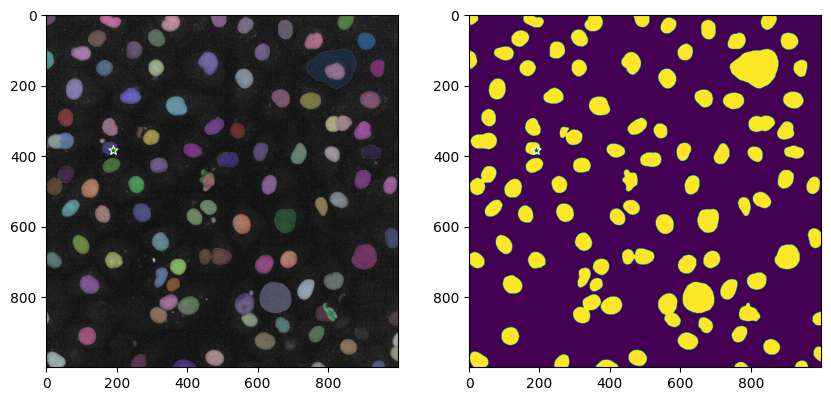

box: [434, 450, 47, 54]
masks_new_auto_result False
[457, 477] is not True in new masks


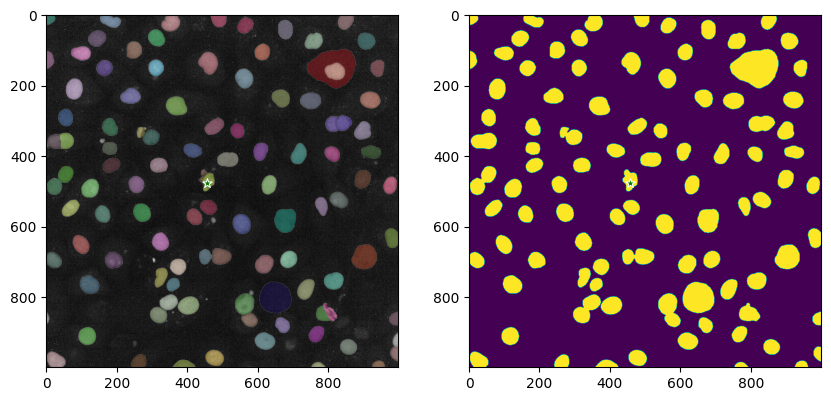

box: [434, 530, 47, 65]
masks_new_auto_result False
[457, 562] is not True in new masks


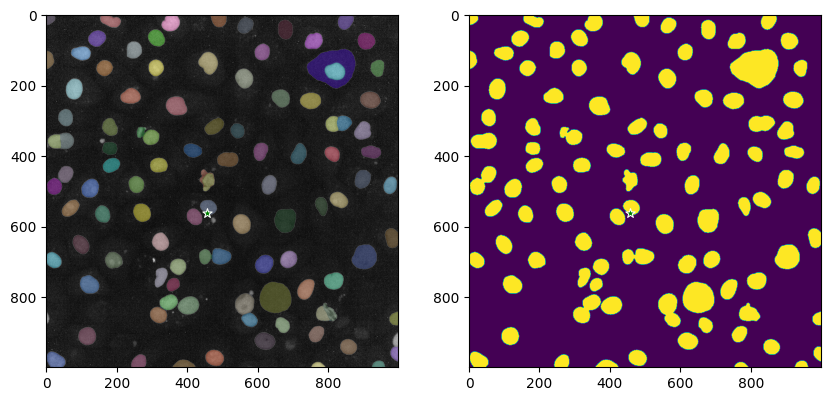

box: [8, 341, 37, 39]
masks_new_auto_result True
[26, 360] is True in new masks


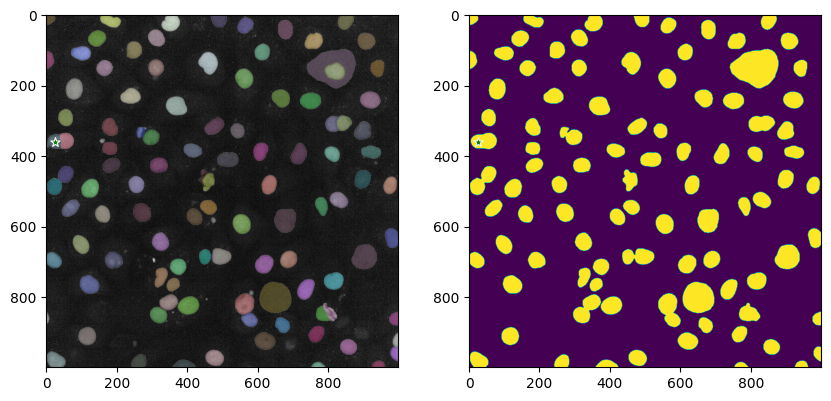

box: [802, 818, 33, 49]
masks_new_auto_result False
[818, 842] is not True in new masks


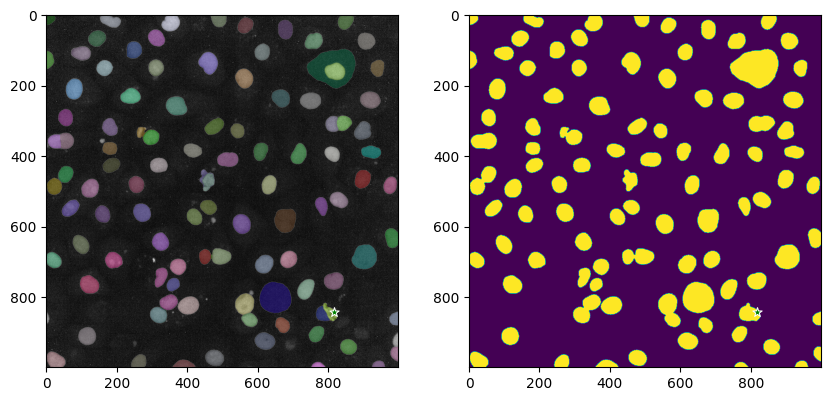

box: [728, 100, 159, 113]
masks_new_auto_result False
[807, 156] is not True in new masks


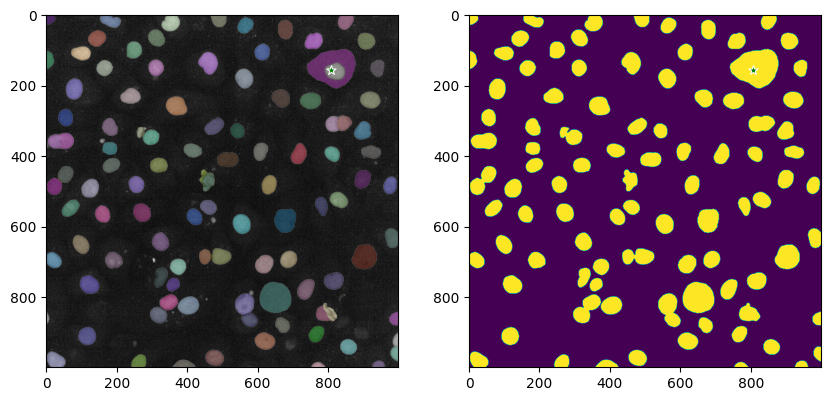

box: [977, 943, 22, 41]
masks_new_auto_result False
[988, 963] is not True in new masks


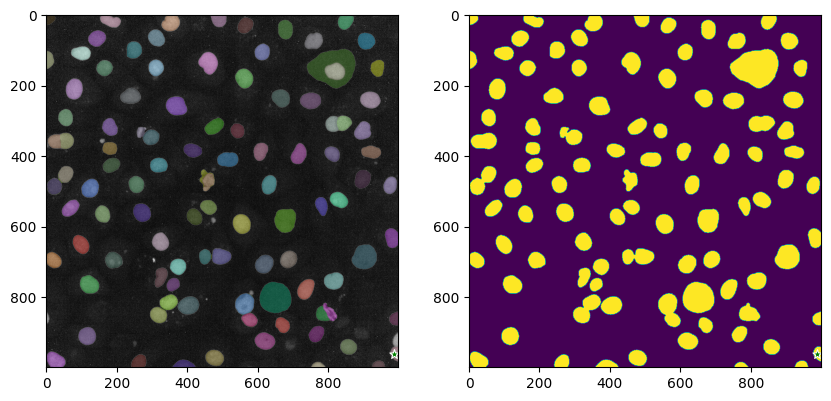

sum is 83


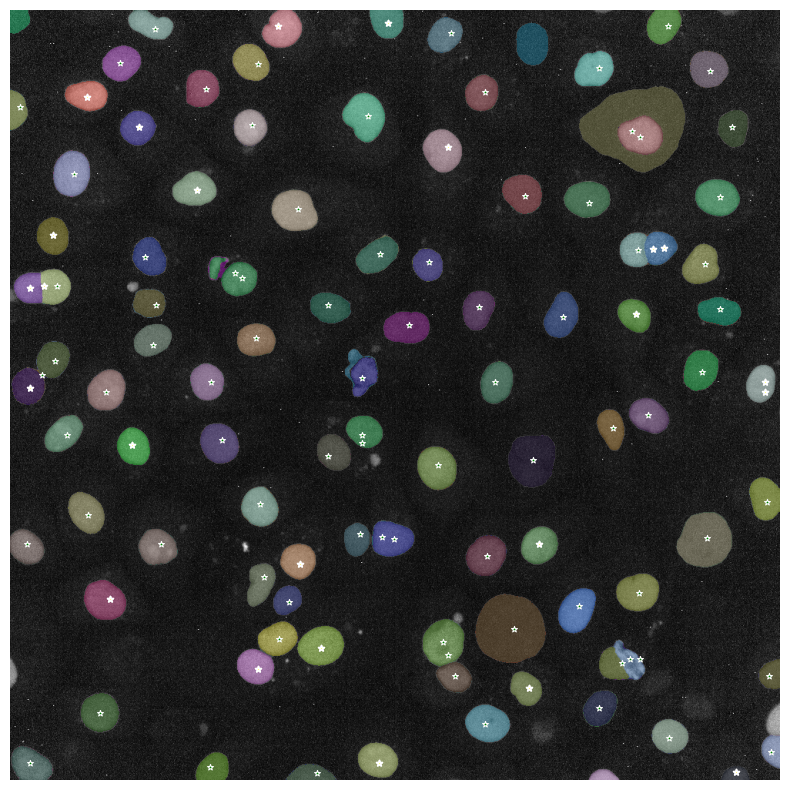

[[124, 495], [26, 977], [619, 708], [314, 149], [188, 24], [902, 329], [275, 558], [630, 483], [738, 773], [373, 258], [828, 525], [617, 927], [922, 243], [751, 250], [260, 483], [117, 913], [254, 102], [616, 106], [321, 69], [817, 757], [319, 425], [498, 686], [142, 68], [609, 385], [324, 641], [74, 552], [259, 982], [413, 579], [555, 591], [83, 212], [818, 164], [764, 75], [175, 320], [101, 655], [196, 693], [855, 945], [679, 584], [21, 693], [12, 125], [572, 30], [982, 638], [909, 79], [457, 551], [58, 455], [349, 816], [668, 241], [465, 137], [854, 20], [41, 474], [185, 435], [301, 347], [518, 408], [562, 820], [482, 684], [718, 398], [782, 542], [898, 469], [544, 327], [61, 358], [454, 680], [578, 864], [413, 383], [480, 316], [362, 768], [921, 388], [568, 837], [654, 803], [765, 906], [398, 990], [815, 311], [330, 736], [985, 864], [937, 151], [905, 685], [794, 848], [292, 341], [805, 843], [189, 382], [457, 477], [457, 562], [818, 842], [807, 156], [988, 963]]
prompts: 83
184164

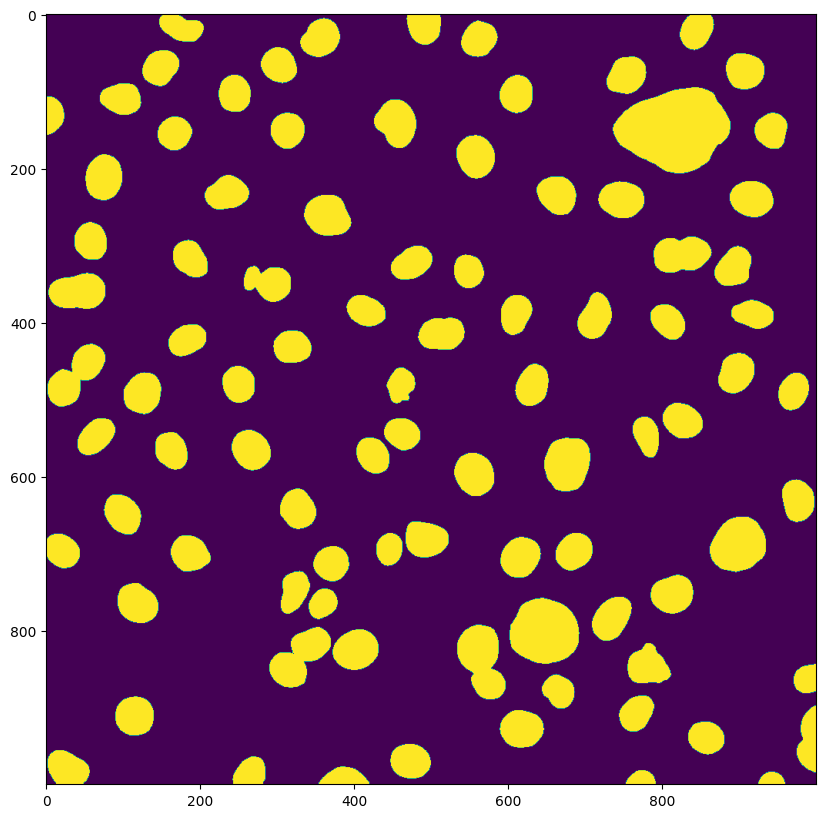

//////////////////
box: [5, 337, 73, 44]
masks_new_auto_result True
[41, 359] is True in new masks


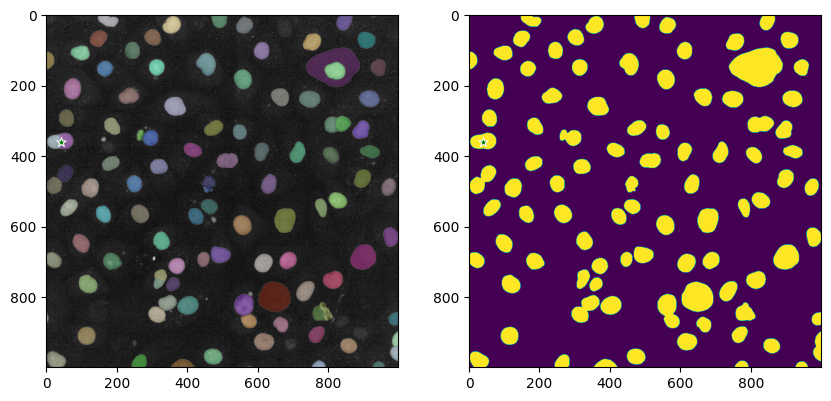

box: [100, 467, 49, 52]
masks_new_auto_result False
[124, 493] is not True in new masks


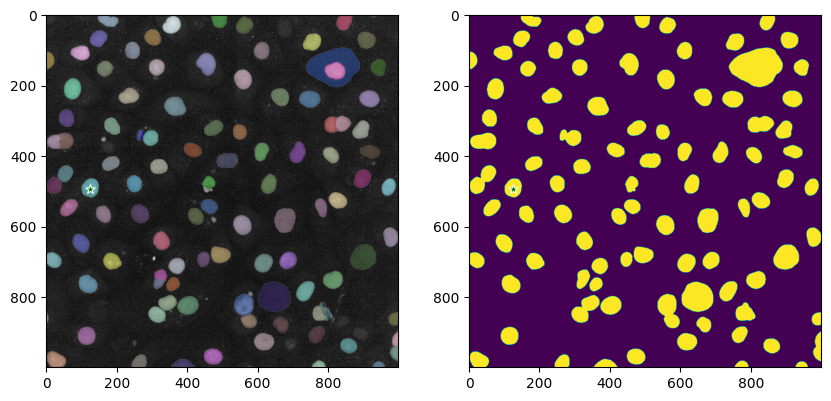

box: [2, 956, 52, 43]
masks_new_auto_result False
[28, 977] is not True in new masks


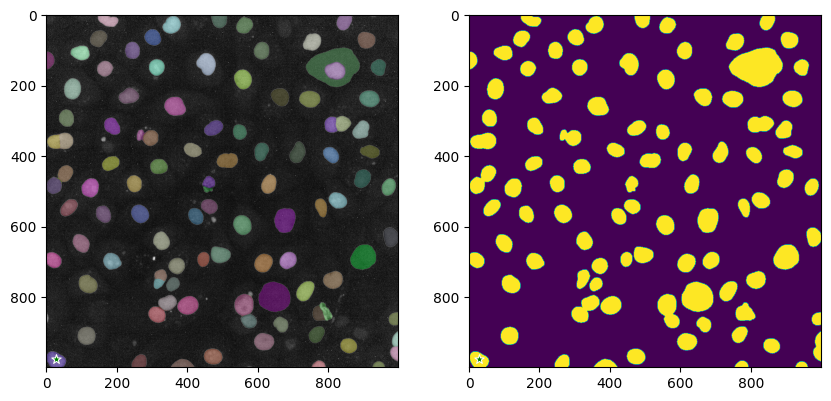

box: [592, 682, 51, 52]
masks_new_auto_result False
[617, 708] is not True in new masks


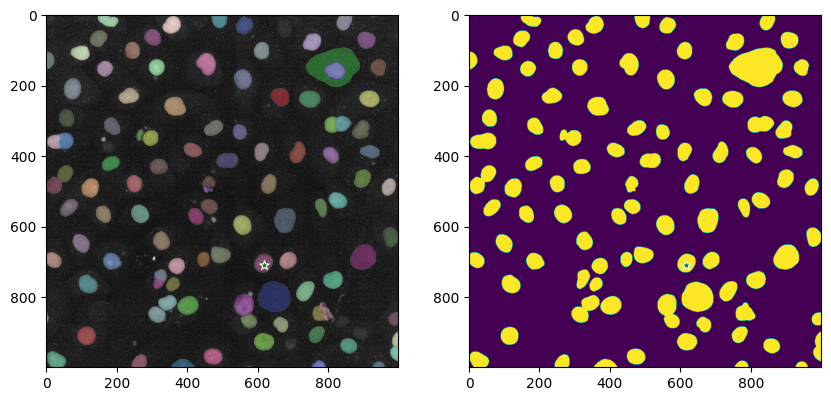

box: [452, 951, 51, 45]
masks_new_auto_result True
[477, 973] is True in new masks


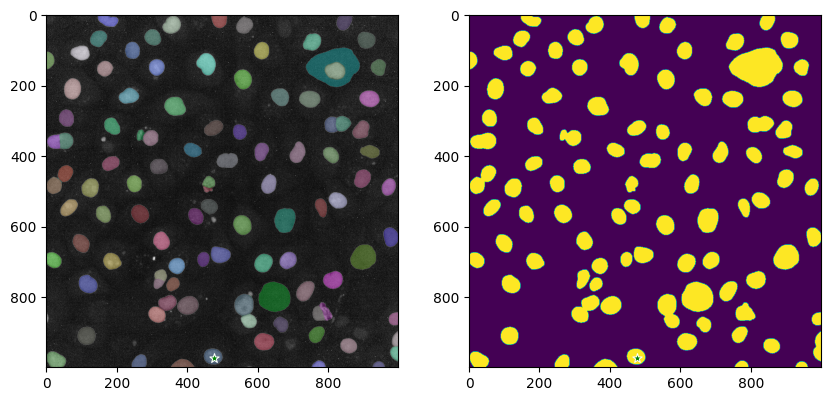

box: [291, 129, 42, 47]
masks_new_auto_result False
[312, 152] is not True in new masks


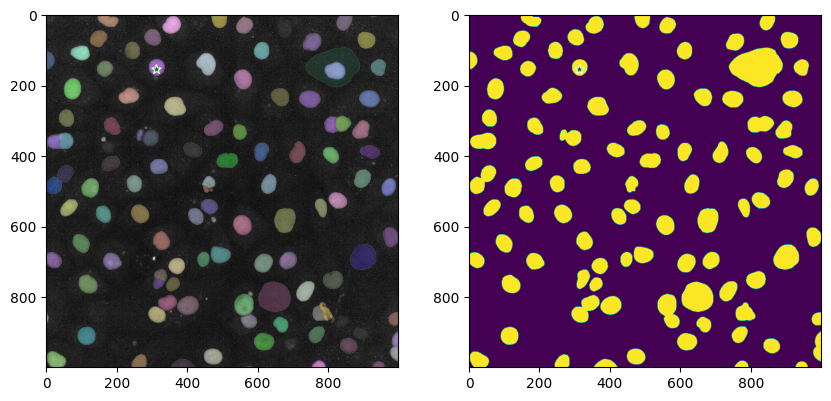

box: [471, 664, 53, 45]
masks_new_auto_result False
[497, 686] is not True in new masks


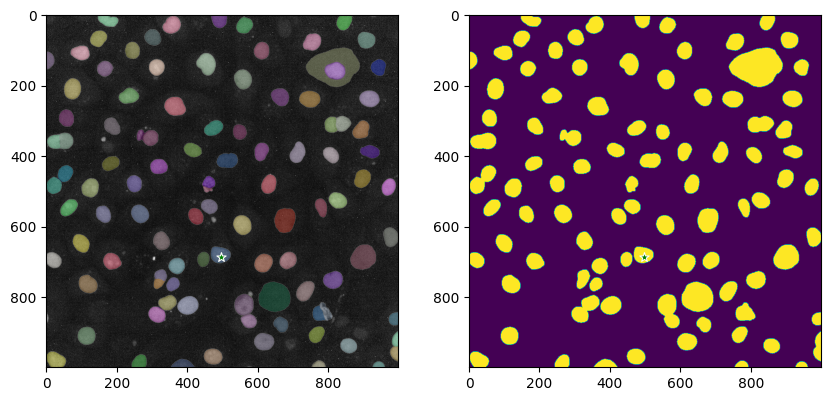

box: [71, 92, 55, 39]
masks_new_auto_result True
[98, 111] is True in new masks


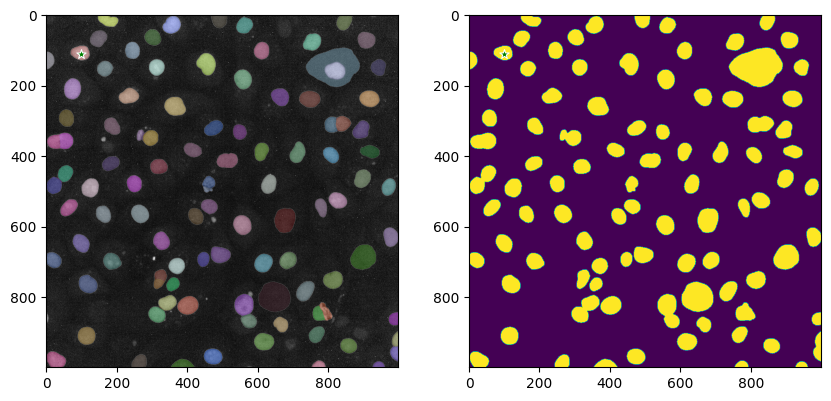

box: [591, 902, 58, 48]
masks_new_auto_result False
[620, 926] is not True in new masks


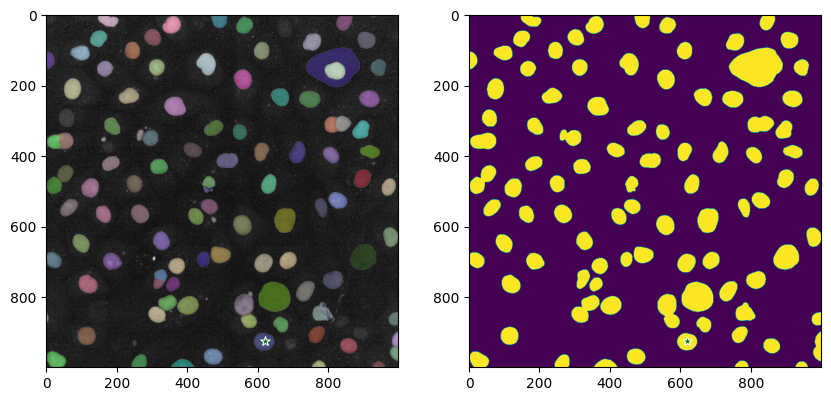

box: [340, 233, 59, 53]
masks_new_auto_result False
[369, 259] is not True in new masks


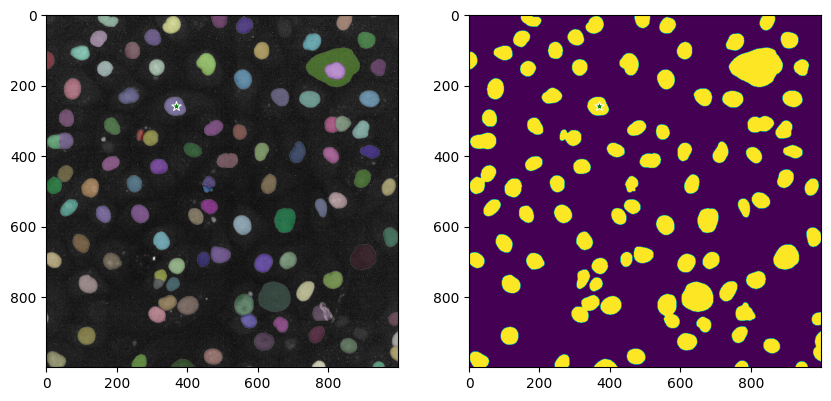

box: [611, 457, 41, 53]
masks_new_auto_result False
[631, 483] is not True in new masks


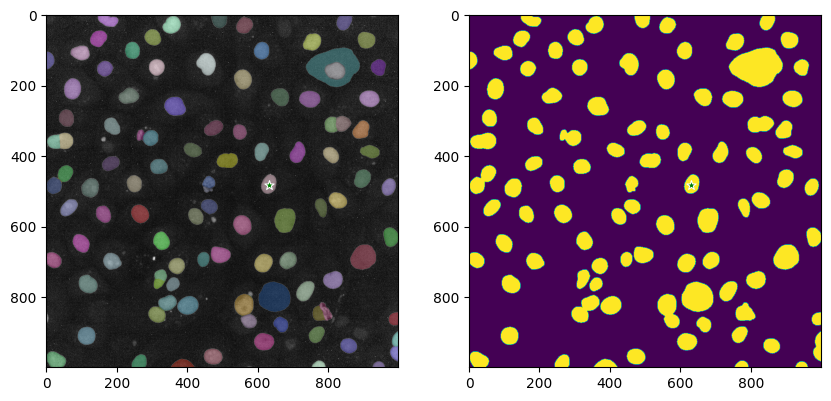

box: [787, 732, 55, 48]
masks_new_auto_result False
[814, 756] is not True in new masks


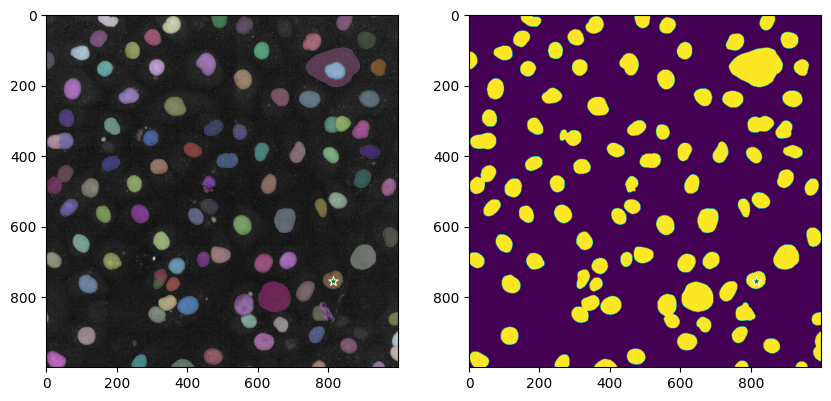

box: [139, 542, 42, 48]
masks_new_auto_result True
[160, 566] is True in new masks


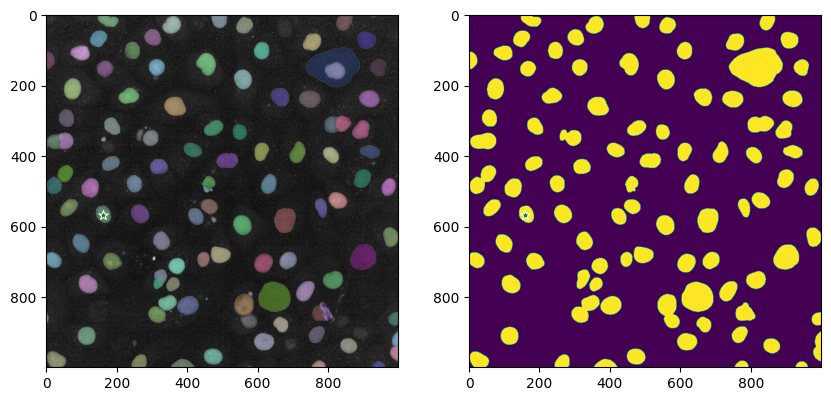

box: [712, 751, 48, 57]
masks_new_auto_result False
[736, 779] is not True in new masks


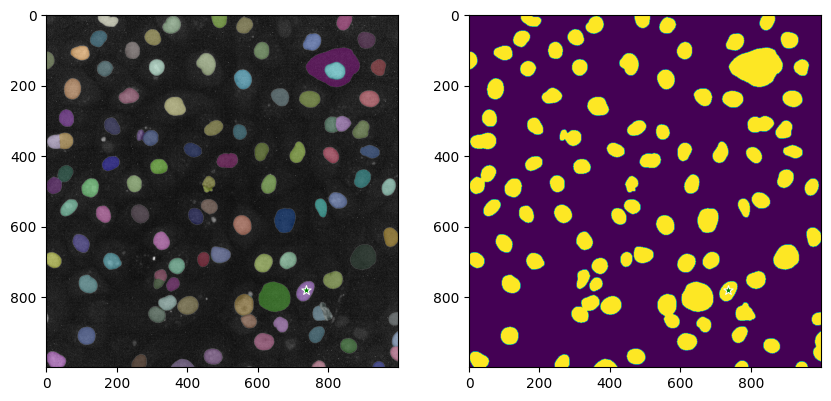

box: [873, 304, 47, 51]
masks_new_auto_result False
[896, 329] is not True in new masks


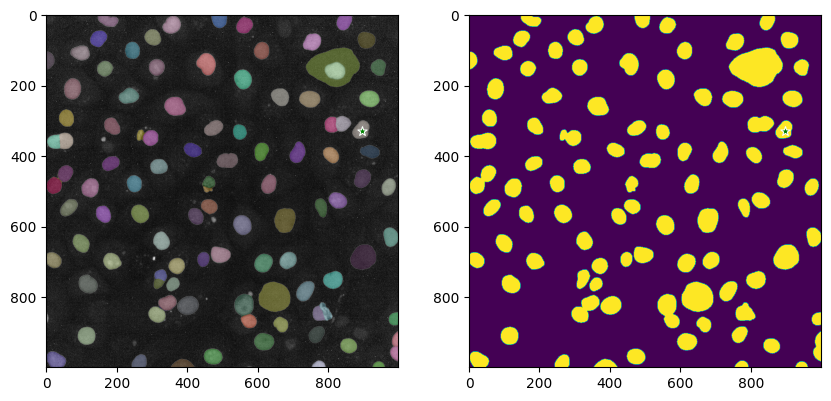

box: [154, 0, 57, 37]
masks_new_auto_result False
[182, 18] is not True in new masks


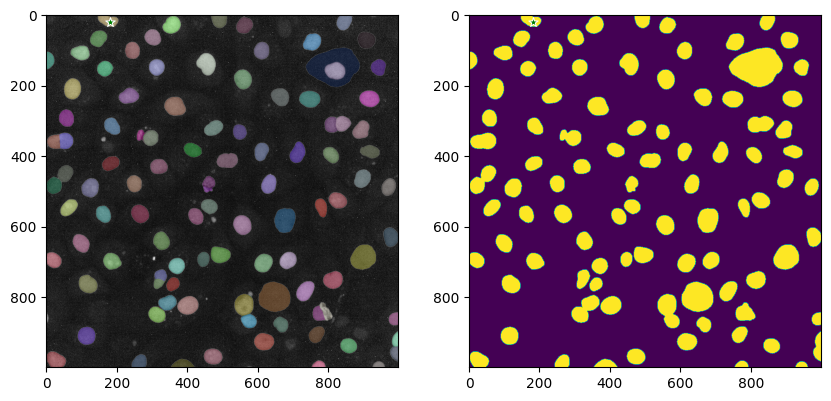

box: [322, 794, 51, 44]
masks_new_auto_result False
[347, 816] is not True in new masks


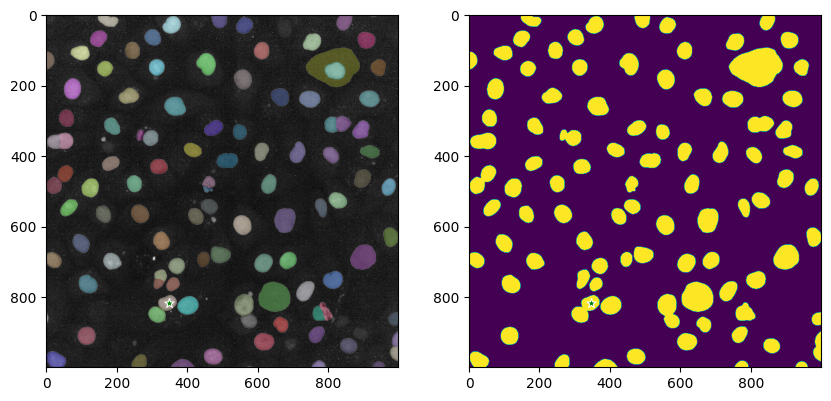

box: [247, 537, 49, 51]
masks_new_auto_result False
[271, 562] is not True in new masks


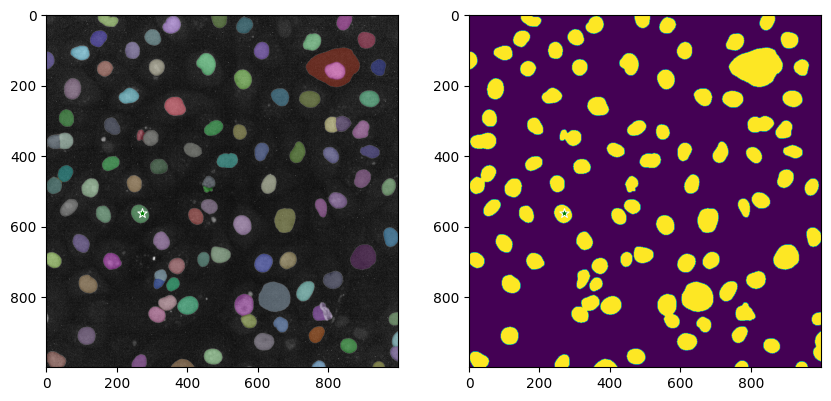

box: [792, 288, 74, 45]
masks_new_auto_result True
[829, 310] is True in new masks


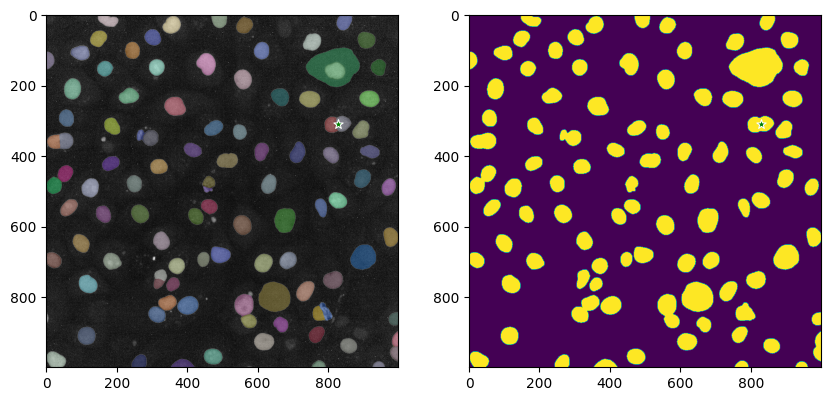

box: [373, 800, 60, 51]
masks_new_auto_result True
[403, 825] is True in new masks


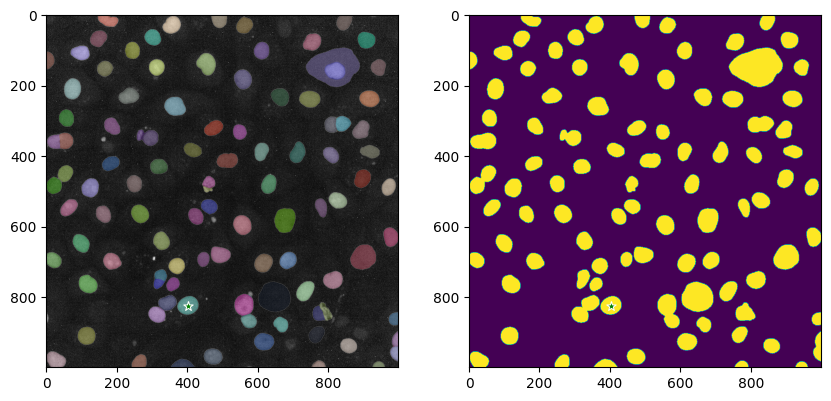

box: [92, 887, 49, 50]
masks_new_auto_result False
[116, 912] is not True in new masks


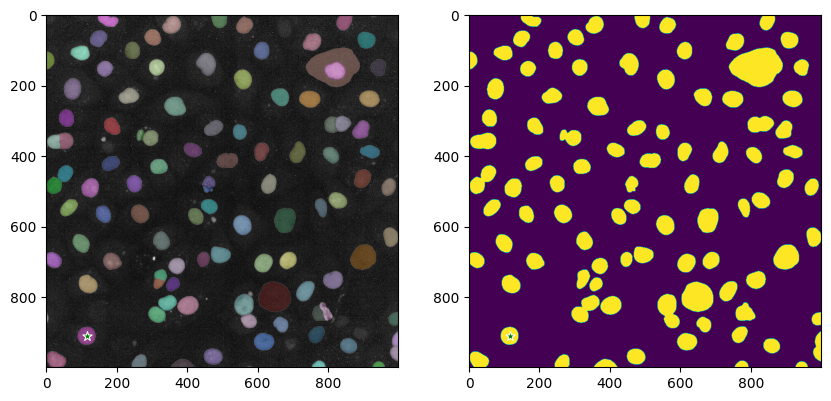

box: [890, 220, 57, 47]
masks_new_auto_result False
[918, 243] is not True in new masks


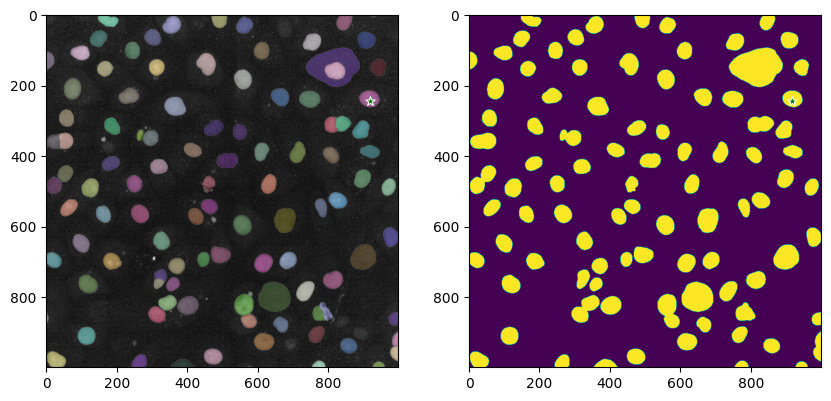

box: [351, 693, 45, 46]
masks_new_auto_result True
[373, 716] is True in new masks


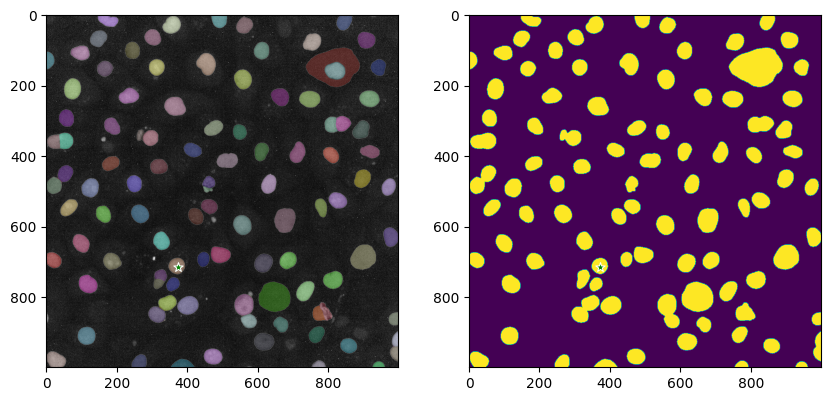

box: [804, 504, 51, 45]
masks_new_auto_result False
[829, 526] is not True in new masks


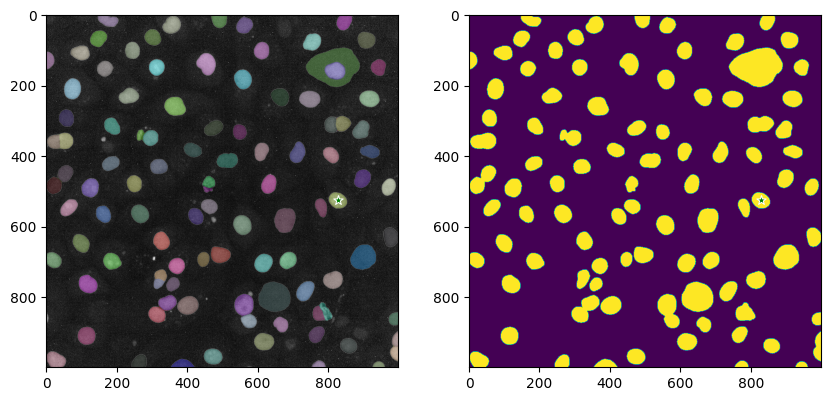

box: [234, 459, 43, 47]
masks_new_auto_result False
[255, 482] is not True in new masks


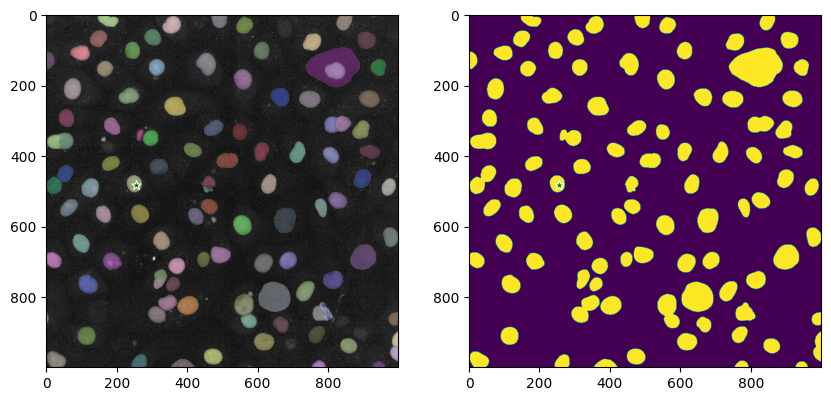

box: [591, 84, 42, 46]
masks_new_auto_result False
[612, 107] is not True in new masks


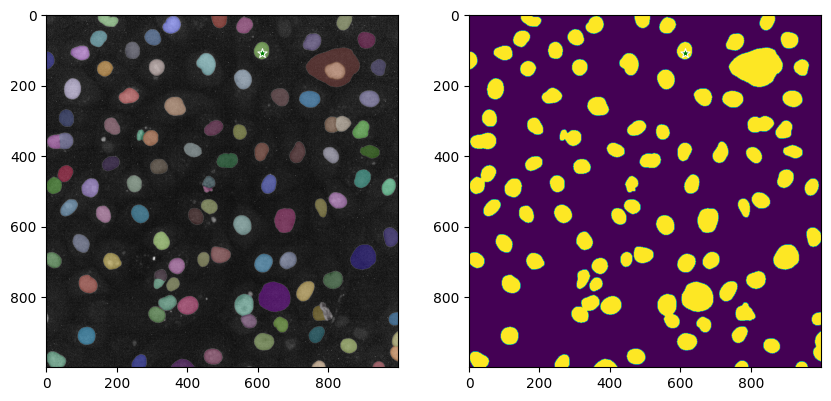

box: [536, 155, 50, 55]
masks_new_auto_result False
[561, 182] is not True in new masks


KeyboardInterrupt: 

In [22]:
mask_generator = SamAutomaticMaskGenerator(sam,pred_iou_thresh=0.95)
img=img_raw[0]
img = img.squeeze()
img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
masks_old = mask_generator.generate(img)
masks_new = masks_old

print('first_frame:')
plt.figure(figsize=(10,10))
plt.imshow(img)
show_anns(masks_new)
# show_points(masks[0]['point_coords'],np.array([1]), plt.gca())
plt.axis('off')
plt.show()
print('/////////////////////////////')
prompts_1 = []
prompts_00 = []
# prompts=[]
for img in img_raw[1:6,:, :, : ]:
    img = img.squeeze()
    img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
    masks_new_auto = mask_generator.generate(img)
    

    prompts_1, prompts_00 = prompts_of_disappear_masks(img, masks_old, masks_new_auto)
    
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    
    for prompt in prompts_1:
        show_points(np.array([prompt]) ,np.array([1]), plt.gca())
        # show_box(np.array([prompt]), plt.gca())
    for prompt_00 in prompts_00:
        show_points_00(np.array([prompt_00]) ,np.array([1]), plt.gca())
        # show_box(np.array([prompt_00]), plt.gca())
    # show_points(masks[0]['point_coords'],np.array([1]), plt.gca())
    masks_new = get_masks_new(img, prompts_1, masks_new_auto)
    show_anns(masks_new)
    plt.axis('off')
    plt.show()
    print(prompts_1)
    print("prompts:",len(prompts_1))
    masks_old=masks_new
